# Generative Adversarial Network (GAN) {-}

training, validating and testing a Generative Adversarial Network (GAN). Here are the process:

- Load the dataset. load and work on ONE image class  of Cars.
- Process the images.
- Build a GAN architecture. There are two levels of image generation requirements:
    - First-level requirement: train and generate images for ONE class of the dataset using vanilla GAN. 
    - Second-level requirement: train and generate images for ONE class of the dataset using the mechanism of ProGAN. construct a light version (a simple incremental network architecture) of it yourself. NOTE: it is fine - Visualize the model behaviors during the training.
- Visualize the generated images.

The dataset you will be working on is CIFAR-10. This dataset consists of 60,000 32x32 colour images in 10 classes, with 6,000 images per class. There are 50,000 training images and 10,000 test images.

Here follows some data samples in the dataset:

![alt text](https://storage.googleapis.com/kaggle-competitions/kaggle/3649/media/cifar-10.png)


In [1]:
# Note: to enable GPU training in Colab, go to Runtime > Change runtime type > Hardware acceleration > Choose GPU from the drop-down list.

!pip install tensorflow_datasets

# Import libraries
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
import keras
from keras import callbacks
from keras import optimizers
from keras.datasets import cifar10
from keras.layers import Dropout, Flatten, Dense, BatchNormalization, Conv2D
from keras.utils import np_utils
from keras import Model

from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt

# First-level requirement
First-level requirement: train and generate images for ONE class of the dataset using vanilla GAN. You are free to choose which class of object you are interested in working on.

In [2]:
          # Get the full dataset (batch_size=-1) in NumPy arrays from the returned tf.Tensor object
cifar10_train = tfds.load(name="cifar10", split=tfds.Split.TRAIN, batch_size=-1 )
cifar10_test = tfds.load(name="cifar10", split=tfds.Split.TEST, batch_size=-1)

# Convert tfds dataset to numpy array records
cifar10_train = tfds.as_numpy(cifar10_train)
cifar10_test = tfds.as_numpy(cifar10_test)

# Seperate feature X and label Y
X_train, y_train = cifar10_train["image"], cifar10_train["label"]
X_test, y_test = cifar10_test["image"], cifar10_test["label"]

# Print shapes of the entire training and test set of CIFAR 10
print("X_train shape: " + str(X_train.shape))
print("X_test shape: " + str(X_test.shape))
print("y_train shape: " + str(y_train.shape))
print("y_test shape: " + str(y_test.shape))

X_train shape: (50000, 32, 32, 3)
X_test shape: (10000, 32, 32, 3)
y_train shape: (50000,)
y_test shape: (10000,)


In [3]:
# Get samples  of a certain label
label = 1 # Class '1' is car. You may change this label to another class label.
train_indices = np.where(y_train == label) # Get indices of the label
train_set = X_train[train_indices] # Get train samples of the label
test_indices = np.where(y_test == label) # Get indices of the label
test_set = X_train[test_indices] # Get test samples of the label

# Print shapes of datasets of the selected class
print("train_set shape of the selected class: " + str(train_set.shape))
print("test_set shape of the selected class: " + str(test_set.shape))

# NOTE: training a GAN does not require to have train/test split. All data samples of the training and the test set are used as real data samples.
# You should merge the training and the test set to get more real data samples, i.e., merge the train_set and the test_set to one dataset which is the real dataset.
# Merge train_set and test_set into one real dataset
real_dataset = np.concatenate((train_set, test_set), axis=0)

# Print the shape of the merged real dataset
print("real_dataset shape: " + str(real_dataset.shape))

train_set shape of the selected class: (5000, 32, 32, 3)
test_set shape of the selected class: (1000, 32, 32, 3)
real_dataset shape: (6000, 32, 32, 3)


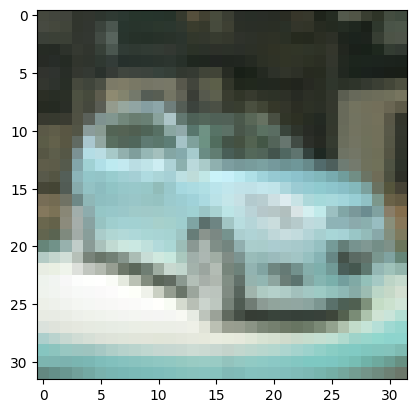

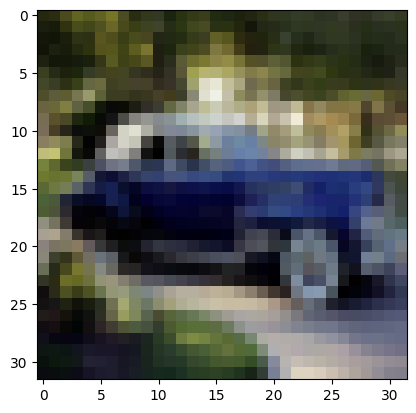

In [4]:
# Visualize some data samples of class '1' (car)
import matplotlib.pyplot as plt
imgplot = plt.imshow(real_dataset[0])
plt.show()
imgplot = plt.imshow(train_set[1])

plt.show()

#Build the Generator

In [5]:
from keras.models import Sequential
from keras.layers import Dense, Reshape, Conv2DTranspose, LeakyReLU, BatchNormalization

# Define the structure of the  Generator for Car class
def define_generator(latent_dim):
    # latent_dim: dimension of the random input vector

    model = Sequential()  # Initialize a sequential model for Generator

    # Foundation for 4x4 image (to match CIFAR-10 image size after upsampling)
    n_nodes = 256 * 4 * 4  # Expected vector size for converting to a feature map
    model.add(Dense(input_dim=latent_dim, units=n_nodes))  # FC layer to convert latent vector to a vector of size n_nodes
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((4, 4, 256)))

    # Upsample from 4x4x256 to 8x8x128 using Conv2DTranspose
    model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    # Upsample from 8x8x128 to 16x16x64 using Conv2DTranspose
    model.add(Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    # Upsample from 16x16x64 to 32x32x3 using Conv2DTranspose
    model.add(Conv2DTranspose(512, (4, 4), strides=(2, 2), padding='same', activation=None))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Conv2D(filters=3, kernel_size=(2,2), strides=(1,1), padding="same", activation="sigmoid"))

    return model  # Return the customized Generator for Car class

# Show a sample of customized Generator structure for Car class
car_generator = define_generator(128)
car_generator.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 4096)              528384    
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 4096)              0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 8, 8, 128)        524416    
 nspose)                                                         
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 16, 16, 256)      524544    
 ranspose)                                              

#Build the Discriminator

In [6]:
from keras.models import Sequential
from keras.layers import Conv2D, LeakyReLU, Dropout, BatchNormalization, GlobalMaxPooling2D, Dense

# Define the structure of Discriminator
def define_discriminator(in_shape=(32, 32, 3)):
    model = Sequential() # Initialize a sequential model for Discriminator

    # Block 1 conv
    model.add(Conv2D(64, (3, 3), strides=(2, 2), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.5))

    # Block 2 conv
    model.add(Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.5))

    # Block 3 conv
    model.add(Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
    #model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.5))

    # Block 4 conv
    model.add(Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
    #model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.5))
    # Block 5 conv
    model.add(Conv2D(256, (3, 3), strides=(1,1), padding='same'))
    #model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.5))

    # Classifier
    model.add(GlobalMaxPooling2D())
    model.add(Dense(1, activation='sigmoid'))

    return model # Return the Discriminator

# Show a sample of Discriminator structure
sample_discriminator = define_discriminator()
sample_discriminator.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 16, 16, 64)        1792      
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 dropout (Dropout)           (None, 16, 16, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 8, 8, 128)         73856     
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 8, 8, 128)         0         
                                                                 
 conv2d_3 (Conv2D)           (None, 4, 4, 256)        

#Build the GAN with Generator and and Discriminator

In [7]:

# Define the GAN network consisting of a Generator and a Discriminator
def define_gan(g_model, d_model):
    # g_model: Generator component
    # d_model: Discriminator component

    model = Sequential() # Initialize a sequential model
    model.add(g_model) # Add the Generator component
    model.add(d_model) # Add the Discriminator component
    return model # Return the GAN

#Prepare the real samples

Real samples shape: (10, 32, 32, 3)
Real labels shape: (10, 1)


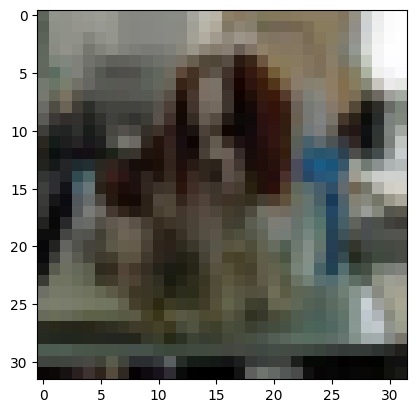

In [8]:

# Normalize the real dataset
def normalize_dataset(dataset):
    # Convert pixel values from unsigned int to float32 for normalization calculation.
    dataset = dataset.astype('float32')
    # Normalize from [0, 255] to [0, 1]
    dataset = dataset / 255.0
    return dataset

# Select real samples from the real dataset for training purpose
def generate_real_samples(real_dataset, n_samples):
    # Normalize the real dataset
    normalized_dataset = normalize_dataset(real_dataset)

    # Generate random n_samples sample indices from the dataset
    ix = np.random.randint(0, normalized_dataset.shape[0], n_samples)
    # Get the images from the list of indices
    X = normalized_dataset[ix]
    # Generate labels for the real samples (label=1)
    y = np.ones((n_samples, 1))
    return X, y # Return the real images and labels.

# Generate 10 real samples from the real dataset
real_samples, real_labels = generate_real_samples(real_dataset, 10)

# Print the shape of the real samples and labels
print("Real samples shape:", real_samples.shape)
print("Real labels shape:", real_labels.shape)
# show some sample
plt.imshow(real_samples[0])
plt.show()

# Generate fake data samples by passing a random vector through the Generator

In [9]:
# Generate random latent vectors as input for Generator
def generate_latent_points(latent_dim, n_samples):
    # Generate points in the latent space
    x_input = np.random.randn(latent_dim * n_samples)
    # Reshape to a batch of inputs for the Generator
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input

# Use Generator to generate n_samples fake samples for Car class
def generate_fake_samples(g_model, latent_dim, n_samples):
    # Generate random latent vectors as input for Generator
    x_input = generate_latent_points(latent_dim, n_samples)
    # Generate fake data samples for Car class by passing the random latent vectors through the Car Generator
    X = g_model.predict(x_input)
    # Generate labels for the fake samples (label=0 for Car class)
    y = np.zeros((n_samples, 1))
    return X, y # Return the fake images and labels for Car class.


# Training process with the Generator and the Discriminator

In [10]:
# Train the Generator and the Discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=201, n_batch=4096):
    bat_per_epo = int(dataset.shape[0] / n_batch) # Number of iterations per epoch
    half_batch = int(n_batch / 2) # A batch to the Discriminator contains real samples (half-batch) and fake samples (half-batch)

    d_loss_values = [] # Array containing Discriminator loss over iterations
    g_loss_values = [] # Array containing Generator loss over iterations

    # Number of epochs
    for i in range(n_epochs):
        # Number of iterations
        for j in range(bat_per_epo):

            # Randomly get half_batch real data samples from the real dataset
            X_real, y_real = generate_real_samples(dataset, half_batch)
            # Generate half_batch fake data samples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # Create training set for the discriminator: half-batch real and half-batch fake
            X = np.concatenate((X_real, X_fake))
            y = np.concatenate((y_real, y_fake))

            # Update discriminator model weights
            d_loss, _ = d_model.train_on_batch(X, y)

            # Generate random latent vectors as input for Generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # Generate inverted labels for the fake samples to train the Generator
            y_gan = np.ones((n_batch, 1))
            # Train the Generator
            g_loss = gan_model.train_on_batch(X_gan, y_gan)

            # Training log after every iteration
            print('Epoch %d, Iteration %d/%d, D_loss = %.3f, G_loss = %.3f' % (i+1, j+1, bat_per_epo, d_loss, g_loss))

            # Add loss values to historical arrays
            d_loss_values.append(d_loss)
            g_loss_values.append(g_loss)

        # Plot the generated images every certain number of epochs
        if (i+1) % 10 == 0:
            X_fake, _ = generate_fake_samples(g_model, latent_dim, 100) # Generate 100 fake data samples using the Generator. Pixel values are in [0,1]
            save_plot(X_fake, i, n=10) # Plot a grid of 10x10 fake samples and save to file at epoch i

    return d_loss_values, g_loss_values # Return the loss arrays of Generator and Discriminator


# Plot the Generator's outputs

In [11]:
# Create and save a plot of generated images
def save_plot(samples, epoch, n=10):
    # Define a plot of (n rows, n columns)
    for i in range(n * n):
        # (1+i) is the index position on a grid with nrows rows and ncols columns. Index starts at 1 in the upper left corner and increases to the right.
        plt.subplot(n, n, 1+i)
        plt.axis('off') # Disable axis
        plt.imshow(samples[i, :, :,:]) # Plot the sample i with reversed gay color map
    filename = 'Plot_epoch_%03d.png' % (epoch+1)
    plt.savefig(filename) # Save plot to file
    plt.show()
    plt.close() # Close the plot

# Main code


8/8 [==============================] - 3s 3ms/step
Epoch 1, Iteration 1/11, D_loss = 0.706, G_loss = 0.655
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 2/11, D_loss = 0.692, G_loss = 0.706
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 3/11, D_loss = 0.689, G_loss = 0.729
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 4/11, D_loss = 0.690, G_loss = 0.742
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 5/11, D_loss = 0.689, G_loss = 0.738
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 6/11, D_loss = 0.687, G_loss = 0.721
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 7/11, D_loss = 0.683, G_loss = 0.717
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 8/11, D_loss = 0.685, G_loss = 0.717
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 9/11, D_loss = 0.679, G_loss = 0.690
8/8 [==============================] 

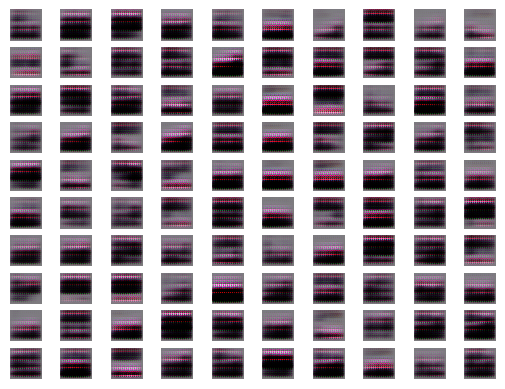

8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 1/11, D_loss = 0.563, G_loss = 0.782
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 2/11, D_loss = 0.581, G_loss = 0.791
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 3/11, D_loss = 0.613, G_loss = 0.812
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 4/11, D_loss = 0.588, G_loss = 0.765
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 5/11, D_loss = 0.626, G_loss = 0.772
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 6/11, D_loss = 0.638, G_loss = 0.798
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 7/11, D_loss = 0.666, G_loss = 0.791
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 8/11, D_loss = 0.732, G_loss = 0.834
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 9/11, D_loss = 0.767, G_loss = 0.851
8/8 [=======================

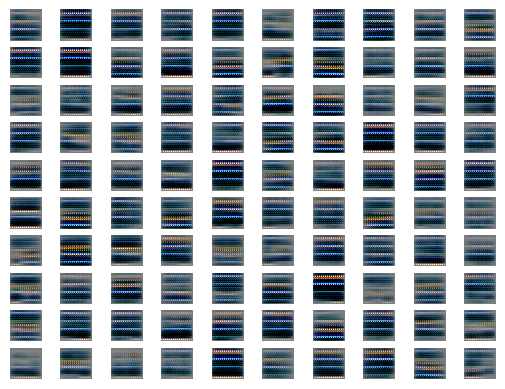

8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 1/11, D_loss = 0.673, G_loss = 0.730
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 2/11, D_loss = 0.634, G_loss = 0.734
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 3/11, D_loss = 0.611, G_loss = 0.732
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 4/11, D_loss = 0.599, G_loss = 0.811
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 5/11, D_loss = 0.580, G_loss = 1.012
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 6/11, D_loss = 0.558, G_loss = 1.009
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 7/11, D_loss = 0.562, G_loss = 1.094
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 8/11, D_loss = 0.587, G_loss = 1.129
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 9/11, D_loss = 0.631, G_loss = 1.190
8/8 [=======================

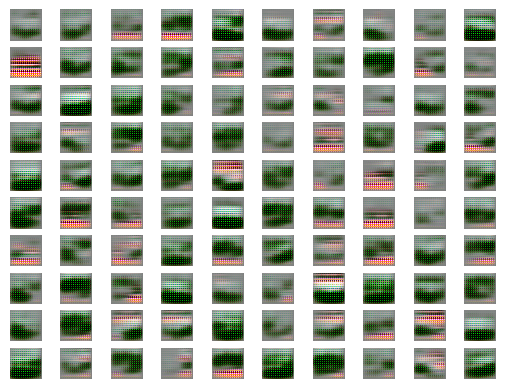

8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 1/11, D_loss = 0.710, G_loss = 0.800
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 2/11, D_loss = 0.671, G_loss = 0.752
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 3/11, D_loss = 0.683, G_loss = 0.777
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 4/11, D_loss = 0.683, G_loss = 0.862
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 5/11, D_loss = 0.673, G_loss = 0.913
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 6/11, D_loss = 0.673, G_loss = 0.932
8/8 [==============================] - 0s 3ms/step
Epoch 31, Iteration 7/11, D_loss = 0.657, G_loss = 0.919
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 8/11, D_loss = 0.639, G_loss = 0.932
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 9/11, D_loss = 0.617, G_loss = 0.961
8/8 [=======================

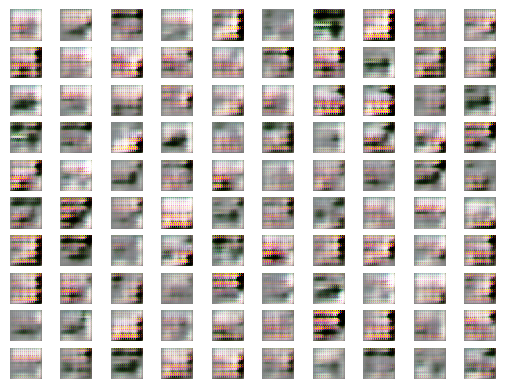

8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 1/11, D_loss = 0.648, G_loss = 1.006
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 2/11, D_loss = 0.649, G_loss = 1.010
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 3/11, D_loss = 0.638, G_loss = 0.975
8/8 [==============================] - 0s 3ms/step
Epoch 41, Iteration 4/11, D_loss = 0.633, G_loss = 0.970
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 5/11, D_loss = 0.633, G_loss = 0.936
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 6/11, D_loss = 0.639, G_loss = 0.963
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 7/11, D_loss = 0.630, G_loss = 0.866
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 8/11, D_loss = 0.652, G_loss = 0.805
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 9/11, D_loss = 0.710, G_loss = 0.805
8/8 [=======================

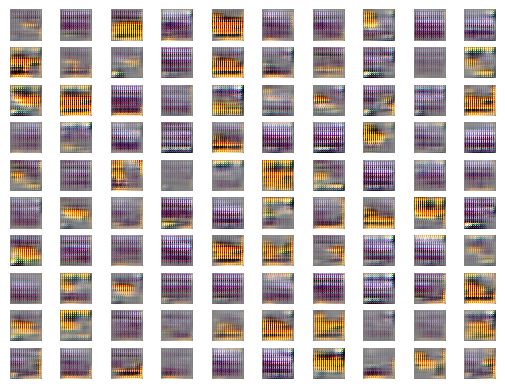

8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 1/11, D_loss = 0.639, G_loss = 0.984
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 2/11, D_loss = 0.636, G_loss = 0.929
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 3/11, D_loss = 0.662, G_loss = 0.914
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 4/11, D_loss = 0.657, G_loss = 0.891
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 5/11, D_loss = 0.672, G_loss = 0.852
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 6/11, D_loss = 0.655, G_loss = 0.818
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 7/11, D_loss = 0.667, G_loss = 0.883
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 8/11, D_loss = 0.650, G_loss = 0.872
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 9/11, D_loss = 0.640, G_loss = 0.774
8/8 [=======================

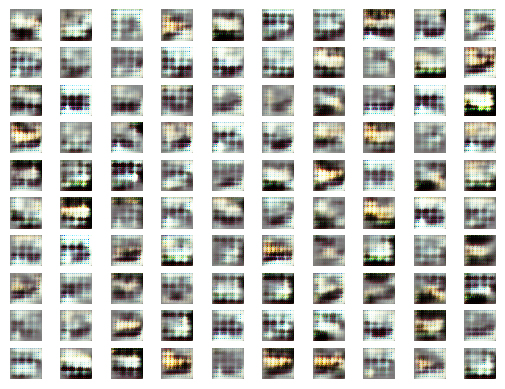

8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 1/11, D_loss = 0.628, G_loss = 1.226
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 2/11, D_loss = 0.677, G_loss = 1.091
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 3/11, D_loss = 0.751, G_loss = 0.971
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 4/11, D_loss = 0.821, G_loss = 0.876
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 5/11, D_loss = 0.780, G_loss = 0.800
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 6/11, D_loss = 0.730, G_loss = 0.790
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 7/11, D_loss = 0.692, G_loss = 0.805
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 8/11, D_loss = 0.675, G_loss = 0.821
8/8 [==============================] - 0s 3ms/step
Epoch 61, Iteration 9/11, D_loss = 0.648, G_loss = 0.860
8/8 [=======================

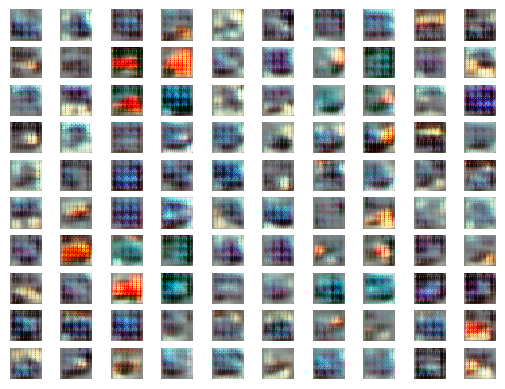

8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 1/11, D_loss = 0.683, G_loss = 0.772
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 2/11, D_loss = 0.672, G_loss = 0.772
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 3/11, D_loss = 0.659, G_loss = 0.764
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 4/11, D_loss = 0.667, G_loss = 0.794
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 5/11, D_loss = 0.648, G_loss = 0.832
8/8 [==============================] - 0s 3ms/step
Epoch 71, Iteration 6/11, D_loss = 0.656, G_loss = 0.832
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 7/11, D_loss = 0.664, G_loss = 0.795
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 8/11, D_loss = 0.667, G_loss = 0.759
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 9/11, D_loss = 0.667, G_loss = 0.825
8/8 [=======================

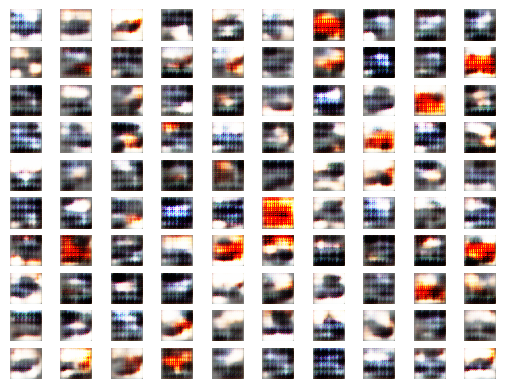

8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 1/11, D_loss = 0.683, G_loss = 0.869
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 2/11, D_loss = 0.693, G_loss = 0.861
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 3/11, D_loss = 0.704, G_loss = 0.868
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 4/11, D_loss = 0.689, G_loss = 0.862
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 5/11, D_loss = 0.686, G_loss = 0.848
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 6/11, D_loss = 0.675, G_loss = 0.834
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 7/11, D_loss = 0.673, G_loss = 0.814
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 8/11, D_loss = 0.667, G_loss = 0.809
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 9/11, D_loss = 0.657, G_loss = 0.795
8/8 [=======================

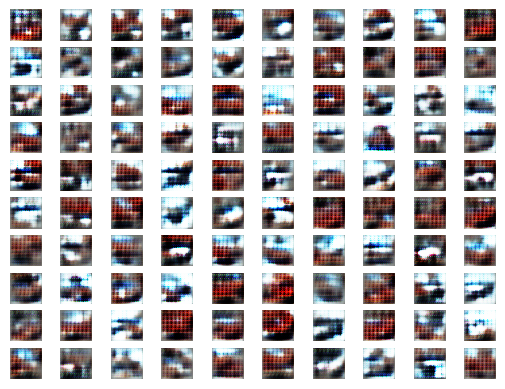

8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 1/11, D_loss = 0.665, G_loss = 1.094
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 2/11, D_loss = 0.624, G_loss = 1.219
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 3/11, D_loss = 0.628, G_loss = 1.049
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 4/11, D_loss = 0.666, G_loss = 0.865
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 5/11, D_loss = 0.711, G_loss = 0.845
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 6/11, D_loss = 0.721, G_loss = 0.802
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 7/11, D_loss = 0.710, G_loss = 0.811
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 8/11, D_loss = 0.687, G_loss = 0.815
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 9/11, D_loss = 0.681, G_loss = 0.815
8/8 [=======================

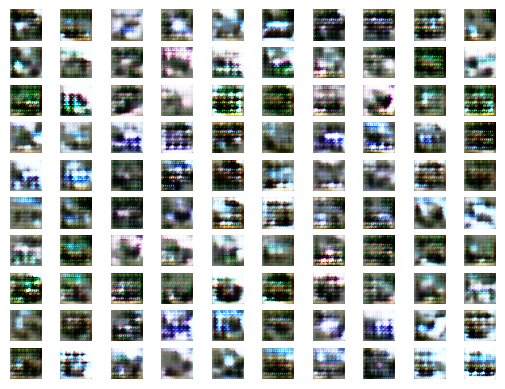

8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 1/11, D_loss = 0.695, G_loss = 0.788
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 2/11, D_loss = 0.709, G_loss = 0.796
8/8 [==============================] - 0s 3ms/step
Epoch 101, Iteration 3/11, D_loss = 0.694, G_loss = 0.789
8/8 [==============================] - 0s 3ms/step
Epoch 101, Iteration 4/11, D_loss = 0.690, G_loss = 0.803
8/8 [==============================] - 0s 3ms/step
Epoch 101, Iteration 5/11, D_loss = 0.665, G_loss = 0.850
8/8 [==============================] - 0s 3ms/step
Epoch 101, Iteration 6/11, D_loss = 0.677, G_loss = 0.843
8/8 [==============================] - 0s 3ms/step
Epoch 101, Iteration 7/11, D_loss = 0.677, G_loss = 0.820
8/8 [==============================] - 0s 5ms/step
Epoch 101, Iteration 8/11, D_loss = 0.694, G_loss = 0.802
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 9/11, D_loss = 0.701, G_loss = 0.826
8/8 [==============

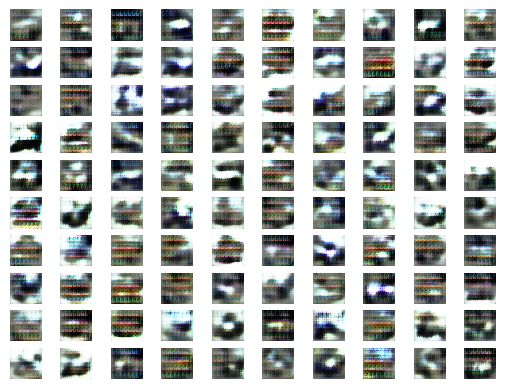

8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 1/11, D_loss = 0.698, G_loss = 0.732
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 2/11, D_loss = 0.699, G_loss = 0.732
8/8 [==============================] - 0s 3ms/step
Epoch 111, Iteration 3/11, D_loss = 0.696, G_loss = 0.739
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 4/11, D_loss = 0.694, G_loss = 0.744
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 5/11, D_loss = 0.667, G_loss = 0.757
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 6/11, D_loss = 0.667, G_loss = 0.768
8/8 [==============================] - 0s 3ms/step
Epoch 111, Iteration 7/11, D_loss = 0.646, G_loss = 0.787
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 8/11, D_loss = 0.637, G_loss = 0.783
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 9/11, D_loss = 0.642, G_loss = 0.814
8/8 [==============

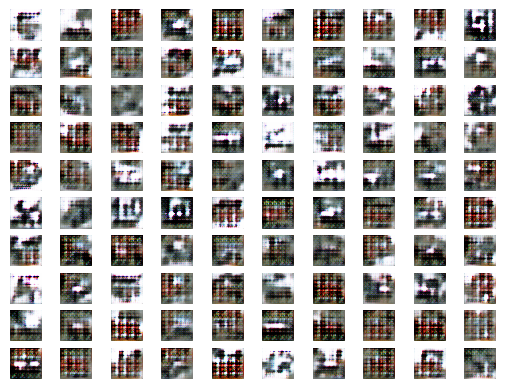

8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 1/11, D_loss = 0.530, G_loss = 1.179
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 2/11, D_loss = 0.561, G_loss = 1.170
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 3/11, D_loss = 0.641, G_loss = 0.966
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 4/11, D_loss = 0.753, G_loss = 0.880
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 5/11, D_loss = 0.772, G_loss = 0.907
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 6/11, D_loss = 0.728, G_loss = 0.963
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 7/11, D_loss = 0.663, G_loss = 1.023
8/8 [==============================] - 0s 3ms/step
Epoch 121, Iteration 8/11, D_loss = 0.628, G_loss = 1.100
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 9/11, D_loss = 0.646, G_loss = 1.113
8/8 [==============

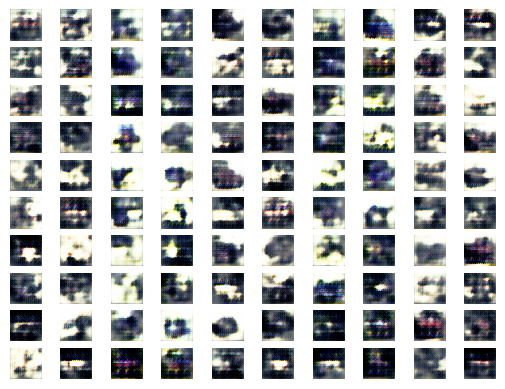

8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 1/11, D_loss = 0.675, G_loss = 0.789
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 2/11, D_loss = 0.665, G_loss = 0.785
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 3/11, D_loss = 0.668, G_loss = 0.769
8/8 [==============================] - 0s 3ms/step
Epoch 131, Iteration 4/11, D_loss = 0.656, G_loss = 0.773
8/8 [==============================] - 0s 3ms/step
Epoch 131, Iteration 5/11, D_loss = 0.644, G_loss = 0.774
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 6/11, D_loss = 0.616, G_loss = 0.777
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 7/11, D_loss = 0.615, G_loss = 0.812
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 8/11, D_loss = 0.607, G_loss = 0.842
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 9/11, D_loss = 0.604, G_loss = 0.929
8/8 [==============

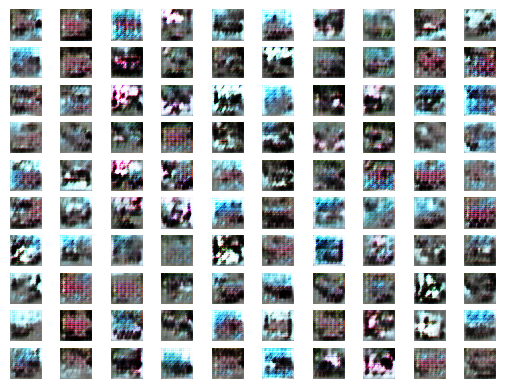

8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 1/11, D_loss = 0.687, G_loss = 0.833
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 2/11, D_loss = 0.665, G_loss = 0.796
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 3/11, D_loss = 0.630, G_loss = 0.778
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 4/11, D_loss = 0.596, G_loss = 0.736
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 5/11, D_loss = 0.582, G_loss = 0.750
8/8 [==============================] - 0s 3ms/step
Epoch 141, Iteration 6/11, D_loss = 0.591, G_loss = 0.798
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 7/11, D_loss = 0.616, G_loss = 0.828
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 8/11, D_loss = 0.620, G_loss = 0.832
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 9/11, D_loss = 0.622, G_loss = 0.819
8/8 [==============

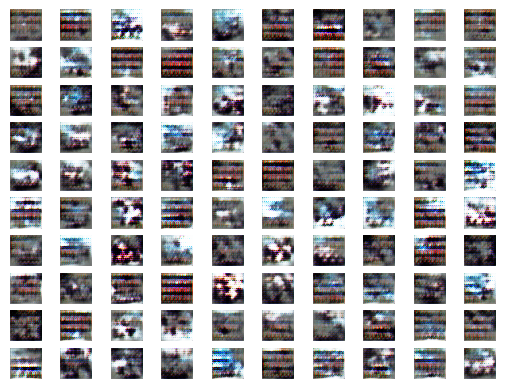

8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 1/11, D_loss = 0.664, G_loss = 0.906
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 2/11, D_loss = 0.664, G_loss = 0.876
8/8 [==============================] - 0s 3ms/step
Epoch 151, Iteration 3/11, D_loss = 0.659, G_loss = 0.845
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 4/11, D_loss = 0.650, G_loss = 0.812
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 5/11, D_loss = 0.679, G_loss = 0.823
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 6/11, D_loss = 0.637, G_loss = 0.796
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 7/11, D_loss = 0.624, G_loss = 0.802
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 8/11, D_loss = 0.614, G_loss = 0.827
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 9/11, D_loss = 0.599, G_loss = 0.872
8/8 [==============

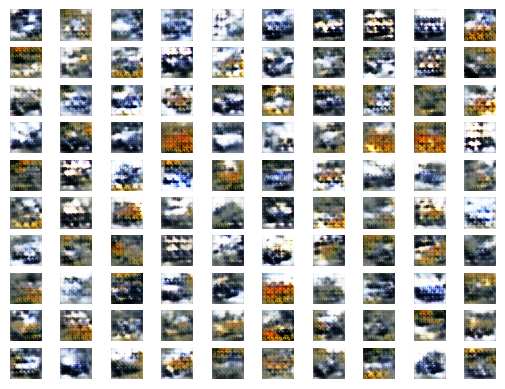

8/8 [==============================] - 0s 3ms/step
Epoch 161, Iteration 1/11, D_loss = 0.685, G_loss = 0.906
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 2/11, D_loss = 0.689, G_loss = 0.889
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 3/11, D_loss = 0.700, G_loss = 0.865
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 4/11, D_loss = 0.706, G_loss = 0.834
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 5/11, D_loss = 0.683, G_loss = 0.837
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 6/11, D_loss = 0.675, G_loss = 0.876
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 7/11, D_loss = 0.655, G_loss = 0.876
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 8/11, D_loss = 0.663, G_loss = 0.905
8/8 [==============================] - 0s 3ms/step
Epoch 161, Iteration 9/11, D_loss = 0.634, G_loss = 0.945
8/8 [==============

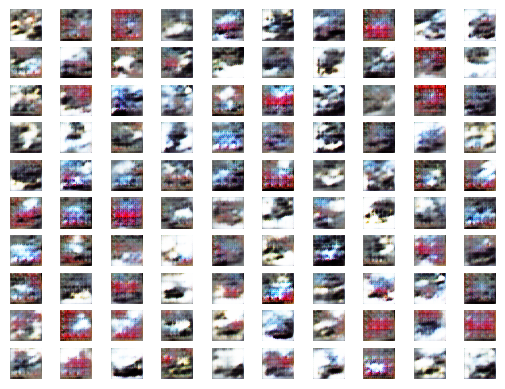

8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 1/11, D_loss = 0.714, G_loss = 1.049
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 2/11, D_loss = 0.697, G_loss = 0.994
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 3/11, D_loss = 0.699, G_loss = 1.032
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 4/11, D_loss = 0.715, G_loss = 1.025
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 5/11, D_loss = 0.729, G_loss = 0.990
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 6/11, D_loss = 0.741, G_loss = 0.996
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 7/11, D_loss = 0.720, G_loss = 0.965
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 8/11, D_loss = 0.690, G_loss = 0.952
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 9/11, D_loss = 0.657, G_loss = 0.951
8/8 [==============

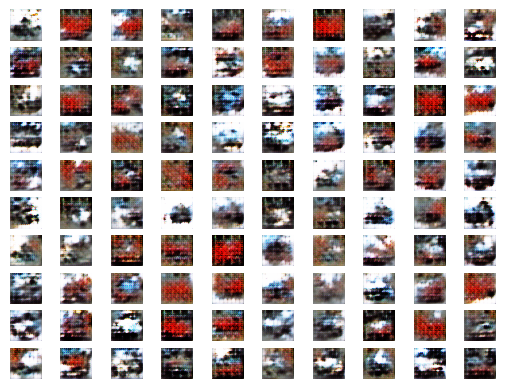

8/8 [==============================] - 0s 3ms/step
Epoch 181, Iteration 1/11, D_loss = 0.690, G_loss = 0.775
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 2/11, D_loss = 0.688, G_loss = 0.778
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 3/11, D_loss = 0.689, G_loss = 0.773
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 4/11, D_loss = 0.680, G_loss = 0.781
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 5/11, D_loss = 0.680, G_loss = 0.776
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 6/11, D_loss = 0.677, G_loss = 0.782
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 7/11, D_loss = 0.677, G_loss = 0.780
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 8/11, D_loss = 0.673, G_loss = 0.793
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 9/11, D_loss = 0.668, G_loss = 0.798
8/8 [==============

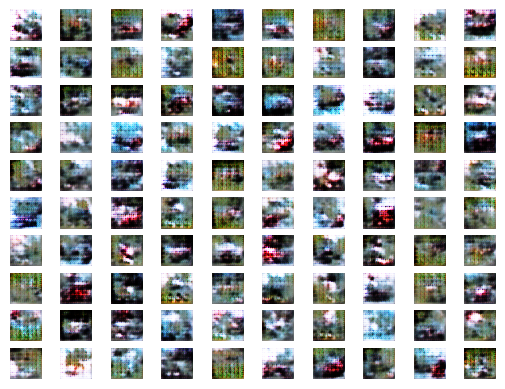

8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 1/11, D_loss = 0.670, G_loss = 0.813
8/8 [==============================] - 0s 3ms/step
Epoch 191, Iteration 2/11, D_loss = 0.650, G_loss = 0.823
8/8 [==============================] - 0s 3ms/step
Epoch 191, Iteration 3/11, D_loss = 0.650, G_loss = 0.820
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 4/11, D_loss = 0.652, G_loss = 0.882
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 5/11, D_loss = 0.655, G_loss = 0.933
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 6/11, D_loss = 0.655, G_loss = 0.921
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 7/11, D_loss = 0.661, G_loss = 0.825
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 8/11, D_loss = 0.684, G_loss = 0.802
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 9/11, D_loss = 0.711, G_loss = 0.781
8/8 [==============

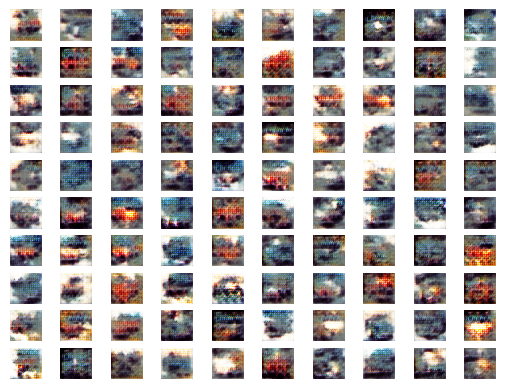

8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 1/11, D_loss = 0.656, G_loss = 0.755
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 2/11, D_loss = 0.645, G_loss = 0.766
8/8 [==============================] - 0s 3ms/step
Epoch 201, Iteration 3/11, D_loss = 0.641, G_loss = 0.756
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 4/11, D_loss = 0.650, G_loss = 0.757
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 5/11, D_loss = 0.639, G_loss = 0.745
8/8 [==============================] - 0s 3ms/step
Epoch 201, Iteration 6/11, D_loss = 0.638, G_loss = 0.756
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 7/11, D_loss = 0.619, G_loss = 0.787
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 8/11, D_loss = 0.637, G_loss = 0.798
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 9/11, D_loss = 0.633, G_loss = 0.821
8/8 [==============

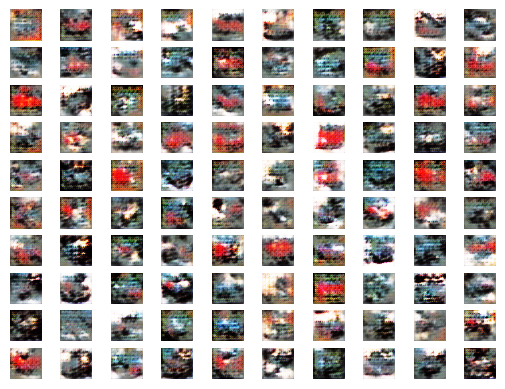

8/8 [==============================] - 0s 3ms/step
Epoch 211, Iteration 1/11, D_loss = 0.701, G_loss = 0.836
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 2/11, D_loss = 0.660, G_loss = 0.826
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 3/11, D_loss = 0.650, G_loss = 0.863
8/8 [==============================] - 0s 3ms/step
Epoch 211, Iteration 4/11, D_loss = 0.653, G_loss = 0.934
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 5/11, D_loss = 0.724, G_loss = 0.917
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 6/11, D_loss = 0.739, G_loss = 0.883
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 7/11, D_loss = 0.726, G_loss = 0.837
8/8 [==============================] - 0s 3ms/step
Epoch 211, Iteration 8/11, D_loss = 0.702, G_loss = 0.805
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 9/11, D_loss = 0.691, G_loss = 0.754
8/8 [==============

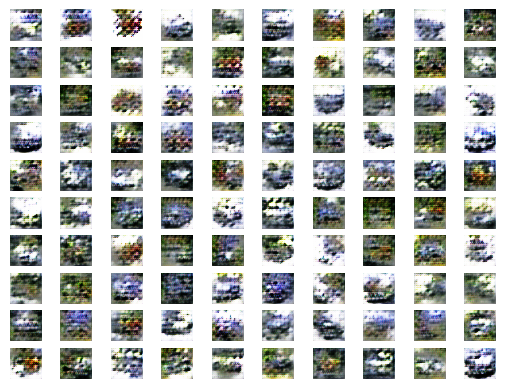

8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 1/11, D_loss = 0.643, G_loss = 0.842
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 2/11, D_loss = 0.654, G_loss = 0.825
8/8 [==============================] - 0s 3ms/step
Epoch 221, Iteration 3/11, D_loss = 0.663, G_loss = 0.864
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 4/11, D_loss = 0.656, G_loss = 0.863
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 5/11, D_loss = 0.665, G_loss = 0.832
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 6/11, D_loss = 0.651, G_loss = 0.833
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 7/11, D_loss = 0.660, G_loss = 0.887
8/8 [==============================] - 0s 3ms/step
Epoch 221, Iteration 8/11, D_loss = 0.639, G_loss = 0.877
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 9/11, D_loss = 0.638, G_loss = 0.866
8/8 [==============

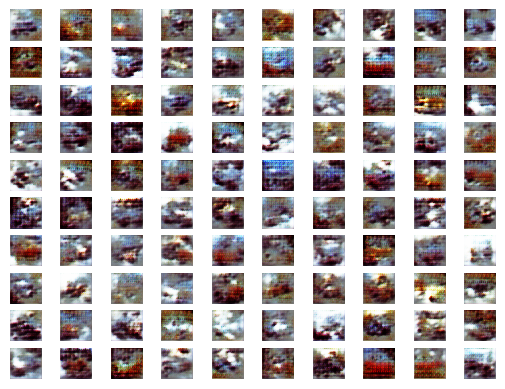

8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 1/11, D_loss = 0.679, G_loss = 0.776
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 2/11, D_loss = 0.674, G_loss = 0.778
8/8 [==============================] - 0s 3ms/step
Epoch 231, Iteration 3/11, D_loss = 0.688, G_loss = 0.789
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 4/11, D_loss = 0.676, G_loss = 0.776
8/8 [==============================] - 0s 3ms/step
Epoch 231, Iteration 5/11, D_loss = 0.669, G_loss = 0.728
8/8 [==============================] - 0s 3ms/step
Epoch 231, Iteration 6/11, D_loss = 0.680, G_loss = 0.701
8/8 [==============================] - 0s 3ms/step
Epoch 231, Iteration 7/11, D_loss = 0.691, G_loss = 0.678
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 8/11, D_loss = 0.692, G_loss = 0.657
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 9/11, D_loss = 0.708, G_loss = 0.646
8/8 [==============

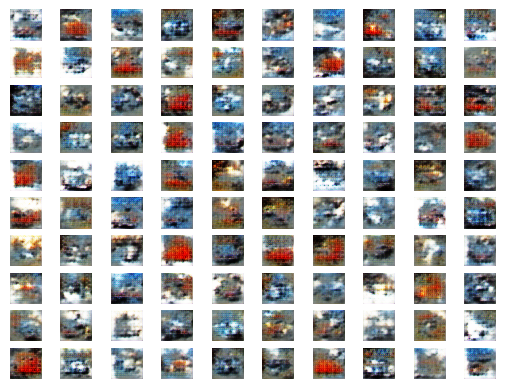

8/8 [==============================] - 0s 3ms/step
Epoch 241, Iteration 1/11, D_loss = 0.747, G_loss = 0.891
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 2/11, D_loss = 0.723, G_loss = 0.848
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 3/11, D_loss = 0.713, G_loss = 0.804
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 4/11, D_loss = 0.702, G_loss = 0.764
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 5/11, D_loss = 0.702, G_loss = 0.735
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 6/11, D_loss = 0.698, G_loss = 0.719
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 7/11, D_loss = 0.695, G_loss = 0.703
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 8/11, D_loss = 0.690, G_loss = 0.696
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 9/11, D_loss = 0.692, G_loss = 0.687
8/8 [==============

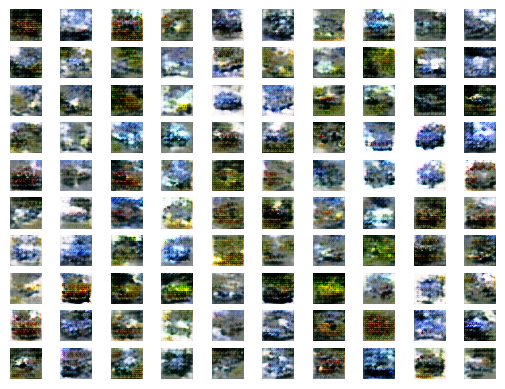

8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 1/11, D_loss = 0.659, G_loss = 0.752
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 2/11, D_loss = 0.657, G_loss = 0.790
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 3/11, D_loss = 0.662, G_loss = 0.811
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 4/11, D_loss = 0.652, G_loss = 0.815
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 5/11, D_loss = 0.659, G_loss = 0.794
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 6/11, D_loss = 0.674, G_loss = 0.808
8/8 [==============================] - 0s 3ms/step
Epoch 251, Iteration 7/11, D_loss = 0.683, G_loss = 0.810
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 8/11, D_loss = 0.700, G_loss = 0.819
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 9/11, D_loss = 0.695, G_loss = 0.826
8/8 [==============

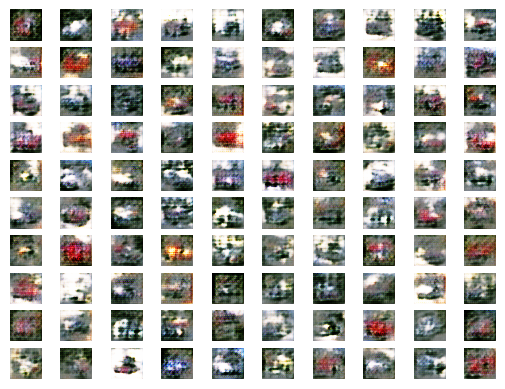

8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 1/11, D_loss = 0.658, G_loss = 0.814
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 2/11, D_loss = 0.648, G_loss = 0.789
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 3/11, D_loss = 0.665, G_loss = 0.788
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 4/11, D_loss = 0.653, G_loss = 0.791
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 5/11, D_loss = 0.650, G_loss = 0.761
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 6/11, D_loss = 0.664, G_loss = 0.797
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 7/11, D_loss = 0.664, G_loss = 0.807
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 8/11, D_loss = 0.696, G_loss = 0.815
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 9/11, D_loss = 0.678, G_loss = 0.738
8/8 [==============

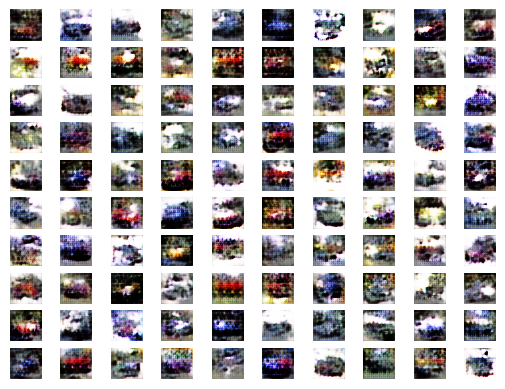

8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 1/11, D_loss = 0.724, G_loss = 0.745
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 2/11, D_loss = 0.696, G_loss = 0.756
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 3/11, D_loss = 0.696, G_loss = 0.795
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 4/11, D_loss = 0.668, G_loss = 0.819
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 5/11, D_loss = 0.664, G_loss = 0.865
8/8 [==============================] - 0s 3ms/step
Epoch 271, Iteration 6/11, D_loss = 0.657, G_loss = 0.869
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 7/11, D_loss = 0.653, G_loss = 0.881
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 8/11, D_loss = 0.642, G_loss = 0.875
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 9/11, D_loss = 0.661, G_loss = 0.816
8/8 [==============

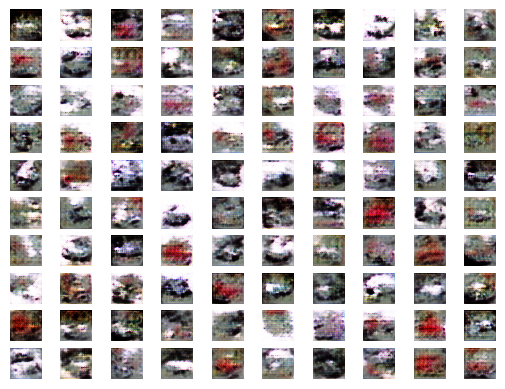

8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 1/11, D_loss = 0.687, G_loss = 0.681
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 2/11, D_loss = 0.693, G_loss = 0.689
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 3/11, D_loss = 0.680, G_loss = 0.688
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 4/11, D_loss = 0.689, G_loss = 0.687
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 5/11, D_loss = 0.686, G_loss = 0.698
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 6/11, D_loss = 0.681, G_loss = 0.697
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 7/11, D_loss = 0.679, G_loss = 0.685
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 8/11, D_loss = 0.680, G_loss = 0.677
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 9/11, D_loss = 0.683, G_loss = 0.691
8/8 [==============

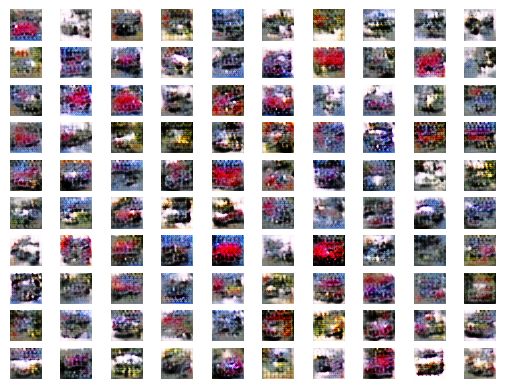

8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 1/11, D_loss = 0.681, G_loss = 0.786
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 2/11, D_loss = 0.690, G_loss = 0.794
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 3/11, D_loss = 0.672, G_loss = 0.804
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 4/11, D_loss = 0.676, G_loss = 0.800
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 5/11, D_loss = 0.656, G_loss = 0.792
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 6/11, D_loss = 0.650, G_loss = 0.790
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 7/11, D_loss = 0.649, G_loss = 0.814
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 8/11, D_loss = 0.647, G_loss = 0.832
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 9/11, D_loss = 0.664, G_loss = 0.846
8/8 [==============

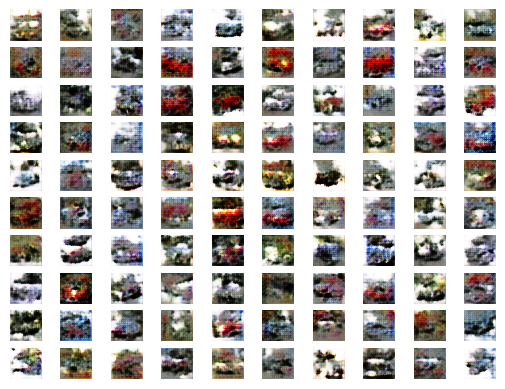

8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 1/11, D_loss = 0.702, G_loss = 0.766
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 2/11, D_loss = 0.698, G_loss = 0.799
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 3/11, D_loss = 0.670, G_loss = 0.755
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 4/11, D_loss = 0.647, G_loss = 0.799
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 5/11, D_loss = 0.642, G_loss = 0.761
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 6/11, D_loss = 0.664, G_loss = 0.907
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 7/11, D_loss = 0.677, G_loss = 0.838
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 8/11, D_loss = 0.654, G_loss = 0.684
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 9/11, D_loss = 0.716, G_loss = 0.864
8/8 [==============

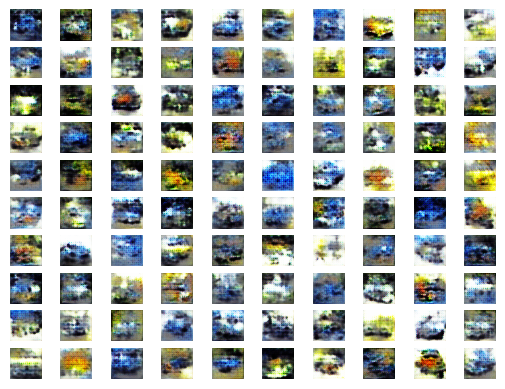

8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 1/11, D_loss = 0.694, G_loss = 0.772
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 2/11, D_loss = 0.696, G_loss = 0.767
8/8 [==============================] - 0s 3ms/step
Epoch 311, Iteration 3/11, D_loss = 0.691, G_loss = 0.762
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 4/11, D_loss = 0.683, G_loss = 0.746
8/8 [==============================] - 0s 3ms/step
Epoch 311, Iteration 5/11, D_loss = 0.687, G_loss = 0.764
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 6/11, D_loss = 0.686, G_loss = 0.752
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 7/11, D_loss = 0.684, G_loss = 0.750
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 8/11, D_loss = 0.689, G_loss = 0.759
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 9/11, D_loss = 0.677, G_loss = 0.763
8/8 [==============

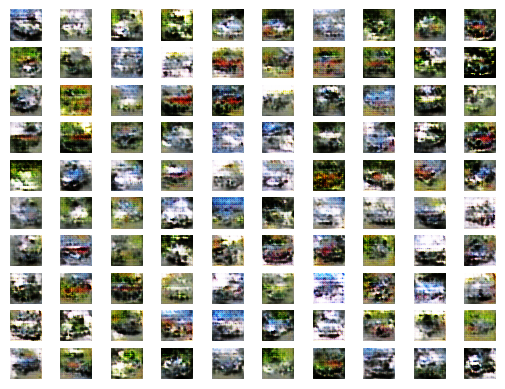

8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 1/11, D_loss = 0.724, G_loss = 0.791
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 2/11, D_loss = 0.708, G_loss = 0.776
8/8 [==============================] - 0s 3ms/step
Epoch 321, Iteration 3/11, D_loss = 0.698, G_loss = 0.763
8/8 [==============================] - 0s 3ms/step
Epoch 321, Iteration 4/11, D_loss = 0.686, G_loss = 0.756
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 5/11, D_loss = 0.678, G_loss = 0.750
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 6/11, D_loss = 0.669, G_loss = 0.749
8/8 [==============================] - 0s 3ms/step
Epoch 321, Iteration 7/11, D_loss = 0.681, G_loss = 0.743
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 8/11, D_loss = 0.683, G_loss = 0.747
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 9/11, D_loss = 0.675, G_loss = 0.761
8/8 [==============

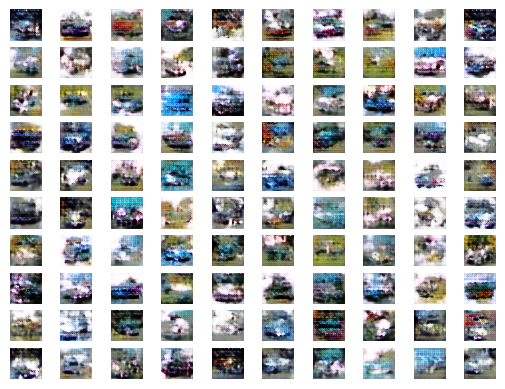

8/8 [==============================] - 0s 3ms/step
Epoch 331, Iteration 1/11, D_loss = 0.680, G_loss = 0.762
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 2/11, D_loss = 0.683, G_loss = 0.745
8/8 [==============================] - 0s 3ms/step
Epoch 331, Iteration 3/11, D_loss = 0.680, G_loss = 0.739
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 4/11, D_loss = 0.681, G_loss = 0.736
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 5/11, D_loss = 0.679, G_loss = 0.741
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 6/11, D_loss = 0.673, G_loss = 0.722
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 7/11, D_loss = 0.686, G_loss = 0.717
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 8/11, D_loss = 0.700, G_loss = 0.733
8/8 [==============================] - 0s 3ms/step
Epoch 331, Iteration 9/11, D_loss = 0.699, G_loss = 0.730
8/8 [==============

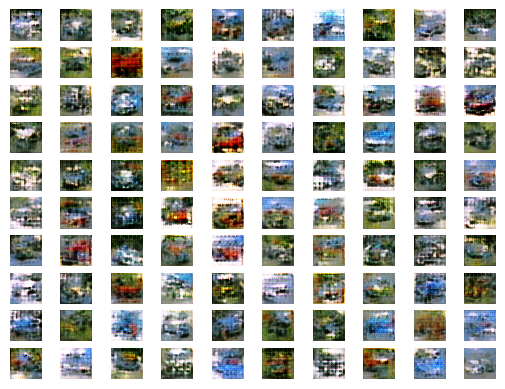

8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 1/11, D_loss = 0.685, G_loss = 0.750
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 2/11, D_loss = 0.712, G_loss = 0.746
8/8 [==============================] - 0s 3ms/step
Epoch 341, Iteration 3/11, D_loss = 0.719, G_loss = 0.776
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 4/11, D_loss = 0.702, G_loss = 0.800
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 5/11, D_loss = 0.697, G_loss = 0.804
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 6/11, D_loss = 0.685, G_loss = 0.820
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 7/11, D_loss = 0.682, G_loss = 0.805
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 8/11, D_loss = 0.669, G_loss = 0.802
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 9/11, D_loss = 0.661, G_loss = 0.798
8/8 [==============

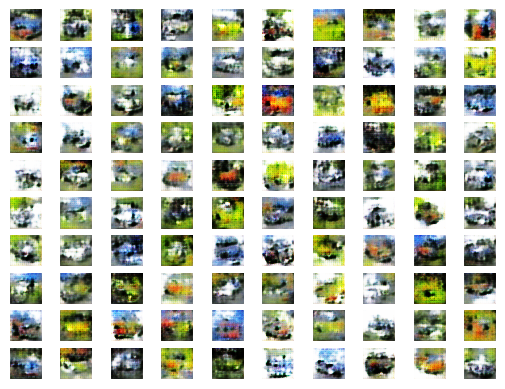

8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 1/11, D_loss = 0.674, G_loss = 0.775
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 2/11, D_loss = 0.675, G_loss = 0.802
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 3/11, D_loss = 0.657, G_loss = 0.798
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 4/11, D_loss = 0.676, G_loss = 0.804
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 5/11, D_loss = 0.667, G_loss = 0.790
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 6/11, D_loss = 0.685, G_loss = 0.798
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 7/11, D_loss = 0.696, G_loss = 0.817
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 8/11, D_loss = 0.699, G_loss = 0.809
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 9/11, D_loss = 0.692, G_loss = 0.769
8/8 [==============

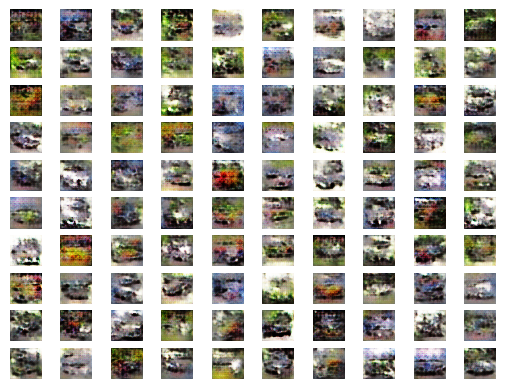

8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 1/11, D_loss = 0.662, G_loss = 0.736
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 2/11, D_loss = 0.675, G_loss = 0.759
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 3/11, D_loss = 0.674, G_loss = 0.739
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 4/11, D_loss = 0.675, G_loss = 0.720
8/8 [==============================] - 0s 3ms/step
Epoch 361, Iteration 5/11, D_loss = 0.658, G_loss = 0.706
8/8 [==============================] - 0s 3ms/step
Epoch 361, Iteration 6/11, D_loss = 0.672, G_loss = 0.748
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 7/11, D_loss = 0.652, G_loss = 0.762
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 8/11, D_loss = 0.673, G_loss = 0.826
8/8 [==============================] - 0s 3ms/step
Epoch 361, Iteration 9/11, D_loss = 0.666, G_loss = 0.778
8/8 [==============

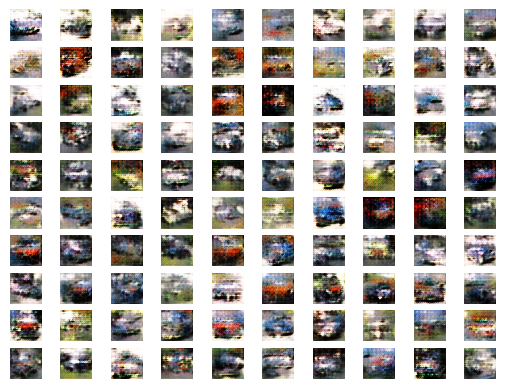

8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 1/11, D_loss = 0.649, G_loss = 0.745
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 2/11, D_loss = 0.636, G_loss = 0.847
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 3/11, D_loss = 0.631, G_loss = 0.815
8/8 [==============================] - 0s 3ms/step
Epoch 371, Iteration 4/11, D_loss = 0.640, G_loss = 0.772
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 5/11, D_loss = 0.643, G_loss = 0.893
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 6/11, D_loss = 0.672, G_loss = 0.810
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 7/11, D_loss = 0.699, G_loss = 0.730
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 8/11, D_loss = 0.726, G_loss = 0.837
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 9/11, D_loss = 0.738, G_loss = 0.817
8/8 [==============

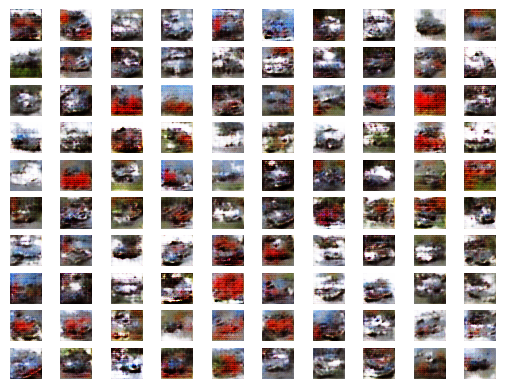

8/8 [==============================] - 0s 3ms/step
Epoch 381, Iteration 1/11, D_loss = 0.677, G_loss = 0.704
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 2/11, D_loss = 0.669, G_loss = 0.694
8/8 [==============================] - 0s 3ms/step
Epoch 381, Iteration 3/11, D_loss = 0.664, G_loss = 0.690
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 4/11, D_loss = 0.652, G_loss = 0.658
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 5/11, D_loss = 0.671, G_loss = 0.675
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 6/11, D_loss = 0.670, G_loss = 0.715
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 7/11, D_loss = 0.665, G_loss = 0.715
8/8 [==============================] - 0s 3ms/step
Epoch 381, Iteration 8/11, D_loss = 0.668, G_loss = 0.713
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 9/11, D_loss = 0.668, G_loss = 0.713
8/8 [==============

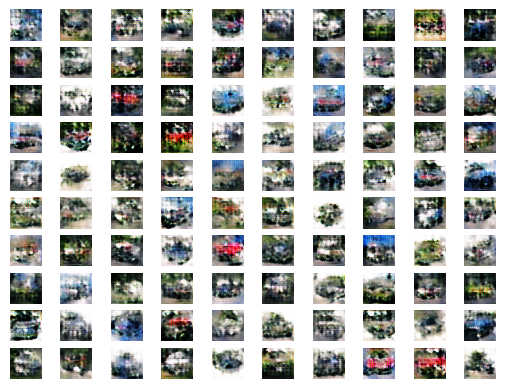

8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 1/11, D_loss = 0.669, G_loss = 0.697
8/8 [==============================] - 0s 3ms/step
Epoch 391, Iteration 2/11, D_loss = 0.662, G_loss = 0.790
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 3/11, D_loss = 0.666, G_loss = 0.810
8/8 [==============================] - 0s 3ms/step
Epoch 391, Iteration 4/11, D_loss = 0.641, G_loss = 0.648
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 5/11, D_loss = 0.703, G_loss = 0.922
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 6/11, D_loss = 0.691, G_loss = 0.928
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 7/11, D_loss = 0.700, G_loss = 0.875
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 8/11, D_loss = 0.696, G_loss = 0.817
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 9/11, D_loss = 0.693, G_loss = 0.778
8/8 [==============

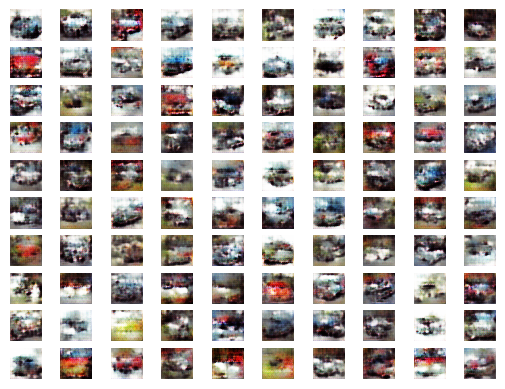

In [12]:
# Import optimization library
from keras.optimizers import Adam, SGD

# Size of the latent space
latent_dim = 128
epochs = 400
batch_size = 512

# Initialize an optimizer. Pick one.
opt = Adam(learning_rate=0.0002, beta_1=0.5) # Adam optimizer with customized values (for the best result)
# opt = Adam() # Adam optimizer with default values
# opt = SGD() # SGD optimizer with default values

# Create the Discriminator
d_model = define_discriminator()
d_model.trainable = True
d_model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])

# Create the Generator
g_model = define_generator(latent_dim)

# Create the GAN
d_model.trainable = False
gan_model = define_gan(g_model, d_model)
gan_model.compile(loss='binary_crossentropy', optimizer=opt)

# Train the GAN
d_losses, g_losses = train(g_model, d_model, gan_model, real_dataset, latent_dim, epochs, batch_size)


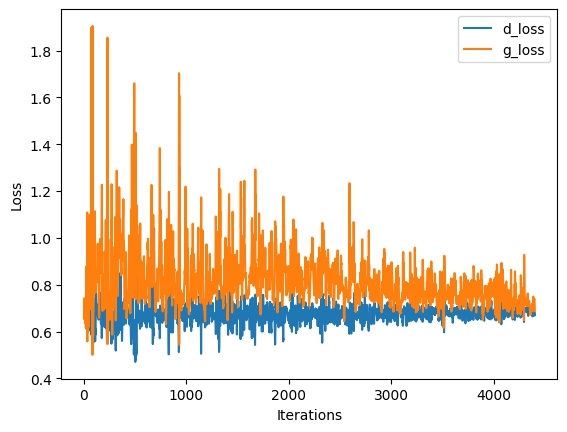

In [13]:
### Plot the training loss of the Generator and the Discriminator over iterations

# Initialize values of x-axis (iterations)
dx = np.linspace(0, len(d_losses), len(d_losses))
gx = np.linspace(0,len(g_losses), len(d_losses))

# Plot the training loss of G and D
plt.plot(dx, d_losses)
plt.plot(gx, g_losses)
plt.ylabel('Loss')
plt.xlabel('Iterations')
plt.legend(['d_loss', 'g_loss'], loc='upper right')
plt.show()

# Save and load the models

In [14]:
# Save the Discriminator, Generator and GAN model
d_model.save('d_model.sav')
g_model.save('g_model.sav')
gan_model.save('gan_model.sav')

#Show some Generated images


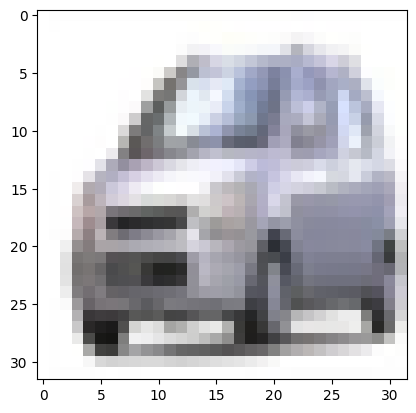

In [15]:
x,y = generate_fake_samples(g_model, latent_dim, 5)
save_plot(x, 400, 5)

# Second-level requirement
Second-level requirement: train and generate images for ONE class of the dataset using the mechanism of ProGAN. In this requirement, you do not need to strictly follow the implementation in the ProGAN paper but feel free to construct a light version (a simple incremental network architecture) of it yourself. NOTE: it is fine to try and fail (i.e., you may not be able to generate good quality images), but at least you give it a try.

In [17]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Conv2D, LeakyReLU, Flatten, BatchNormalization, UpSampling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam


#build Generator for ProGAN

In [18]:
def build_generator(latent_dim, start_shape=(4, 4, 64)):
    inputs = Input(shape=(latent_dim,))
    x = Dense(tf.reduce_prod(start_shape))(inputs)
    x = Reshape(start_shape)(x)

    while start_shape[0] < 32:
        x = Conv2D(filters=start_shape[-1], kernel_size=(3, 3), strides=(1, 1), padding='same')(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = BatchNormalization()(x)
        x = UpSampling2D()(x)
        start_shape = (start_shape[0] * 2, start_shape[1] * 2, start_shape[2] // 2)

    x = Conv2D(3, (1, 1), activation='sigmoid', padding='same')(x)  # Output layer with 3 channels (RGB)

    model = Model(inputs, x, name='generator')
    return model


#Build Discriminator for ProGAN

In [19]:

def build_discriminator(img_shape=(32, 32, 3)):
    inputs = Input(shape=img_shape)
    x = Conv2D(64, (3, 3), strides=(1, 1), padding='same')(inputs)
    x = LeakyReLU(alpha=0.2)(x)

    while img_shape[0] > 4:
        x = Conv2D(filters=img_shape[-1], kernel_size=(3, 3), strides=(2, 2), padding='same')(x)
        x = LeakyReLU(alpha=0.2)(x)
        img_shape = (img_shape[0] // 2, img_shape[1] // 2, img_shape[2] * 2)

    x = Flatten()(x)
    x = Dense(1, activation='sigmoid')(x)

    model = Model(inputs, x, name='discriminator')
    return model


#Build ProGAN by combining Generator and Discriminator

In [20]:
def build_progan(latent_dim, start_shape=(4, 4, 64)):
    discriminator = build_discriminator()
    discriminator.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5), metrics=['accuracy'])

    generator = build_generator(latent_dim, start_shape=start_shape)
    z = Input(shape=(latent_dim,))
    img = generator(z)
    discriminator.trainable = False

    valid = discriminator(img)

    gan = Model(z, valid)
    gan.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5))

    return gan, generator, discriminator


In [21]:
### Train the Generator and the Discriminator
def train_progan(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=201, n_batch=4096):
    bat_per_epo = int(dataset.shape[0] / n_batch) # Number of iterations per epoch
    half_batch = int(n_batch / 2) # A batch to the Discriminator contains real samples (half-batch) and fake samples (half-batch)

    d_loss_values = [] # Array containing Discriminator loss over iterations
    g_loss_values = [] # Array containing Generator loss over iterations

    # Number of epochs
    for i in range(n_epochs):
        # Number of iterations
        for j in range(bat_per_epo):

            # Randomly get half_batch real data samples from the real dataset
            X_real, y_real = generate_real_samples(dataset, half_batch)
            # Generate half_batch fake data samples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # Create training set for the discriminator: half-batch real and half-batch fake
            X = np.concatenate((X_real, X_fake))
            y = np.concatenate((y_real, y_fake))

            # Update discriminator model weights
            d_loss, _ = d_model.train_on_batch(X, y)

            # Generate random latent vectors as input for Generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # Generate inverted labels for the fake samples to train the Generator
            y_gan = np.ones((n_batch, 1))
            # Train the Generator
            g_loss = gan_model.train_on_batch(X_gan, y_gan)

            # Training log after every iteration
            print('Epoch %d, Iteration %d/%d, D_loss = %.3f, G_loss = %.3f' % (i+1, j+1, bat_per_epo, d_loss, g_loss))

            # Add loss values to historical arrays
            d_loss_values.append(d_loss)
            g_loss_values.append(g_loss)

        # Plot the generated images every certain number of epochs
        if (i+1) % 10 == 0:
            X_fake, _ = generate_fake_samples(g_model, latent_dim, 100) # Generate 100 fake data samples using the Generator. Pixel values are in [0,1]
            save_plot_progan(X_fake, i, n=10) # Plot a grid of 10x10 fake samples and save to file at epoch i

    return d_loss_values, g_loss_values # Return the loss arrays of Generator and Discriminator


In [22]:
### Create and save a plot of generated images
def save_plot_progan(samples, epoch, n=10):
    # Define a plot of (n rows, n columns)
    for i in range(n * n):
        # (1+i) is the index position on a grid with nrows rows and ncols columns. Index starts at 1 in the upper left corner and increases to the right.
        plt.subplot(n, n, 1+i)
        plt.axis('off') # Disable axis
        plt.imshow(samples[i, :, :, :]) # Plot the sample i with reversed gay color map
    filename = 'Plot_progan_epoch_%03d.png' % (epoch+1)
    plt.show()
    plt.savefig(filename) # Save plot to file
    plt.close() # Close the plot

8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 1/11, D_loss = 0.693, G_loss = 0.683
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 2/11, D_loss = 0.693, G_loss = 0.669
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 3/11, D_loss = 0.692, G_loss = 0.654
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 4/11, D_loss = 0.692, G_loss = 0.641
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 5/11, D_loss = 0.692, G_loss = 0.628
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 6/11, D_loss = 0.692, G_loss = 0.615
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 7/11, D_loss = 0.691, G_loss = 0.604
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 8/11, D_loss = 0.691, G_loss = 0.590
8/8 [==============================] - 0s 2ms/step
Epoch 1, Iteration 9/11, D_loss = 0.691, G_loss = 0.580
8/8 [==============================] 

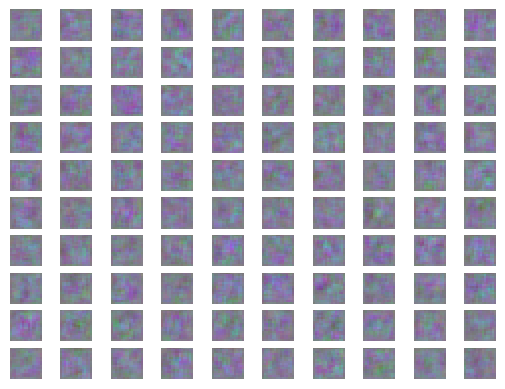

8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 1/11, D_loss = 0.281, G_loss = 0.299
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 2/11, D_loss = 0.258, G_loss = 0.298
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 3/11, D_loss = 0.252, G_loss = 0.297
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 4/11, D_loss = 0.257, G_loss = 0.296
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 5/11, D_loss = 0.263, G_loss = 0.296
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 6/11, D_loss = 0.260, G_loss = 0.295
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 7/11, D_loss = 0.251, G_loss = 0.295
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 8/11, D_loss = 0.246, G_loss = 0.294
8/8 [==============================] - 0s 2ms/step
Epoch 11, Iteration 9/11, D_loss = 0.247, G_loss = 0.293
8/8 [=======================

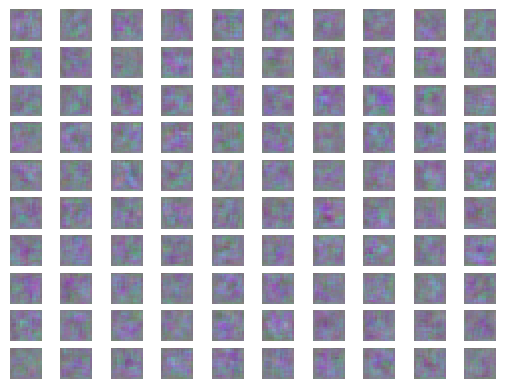

8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 1/11, D_loss = 0.060, G_loss = 0.262
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 2/11, D_loss = 0.060, G_loss = 0.262
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 3/11, D_loss = 0.060, G_loss = 0.261
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 4/11, D_loss = 0.056, G_loss = 0.261
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 5/11, D_loss = 0.048, G_loss = 0.261
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 6/11, D_loss = 0.051, G_loss = 0.260
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 7/11, D_loss = 0.041, G_loss = 0.260
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 8/11, D_loss = 0.046, G_loss = 0.260
8/8 [==============================] - 0s 2ms/step
Epoch 21, Iteration 9/11, D_loss = 0.040, G_loss = 0.261
8/8 [=======================

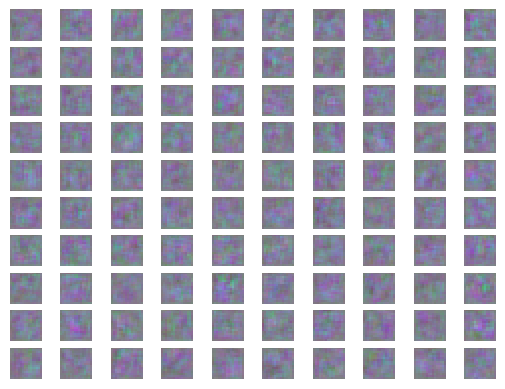

8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 1/11, D_loss = 0.018, G_loss = 0.256
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 2/11, D_loss = 0.021, G_loss = 0.256
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 3/11, D_loss = 0.026, G_loss = 0.256
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 4/11, D_loss = 0.026, G_loss = 0.256
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 5/11, D_loss = 0.023, G_loss = 0.255
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 6/11, D_loss = 0.020, G_loss = 0.256
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 7/11, D_loss = 0.019, G_loss = 0.258
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 8/11, D_loss = 0.019, G_loss = 0.256
8/8 [==============================] - 0s 2ms/step
Epoch 31, Iteration 9/11, D_loss = 0.018, G_loss = 0.256
8/8 [=======================

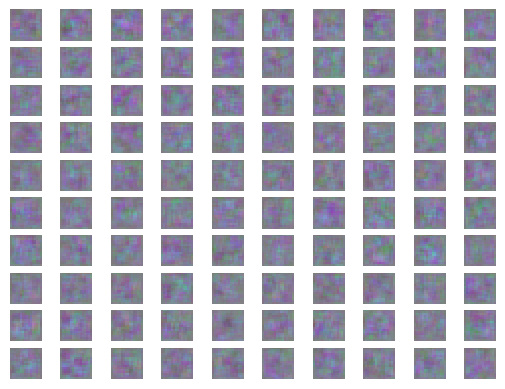

8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 1/11, D_loss = 0.009, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 2/11, D_loss = 0.037, G_loss = 0.253
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 3/11, D_loss = 0.017, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 4/11, D_loss = 0.012, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 5/11, D_loss = 0.008, G_loss = 0.253
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 6/11, D_loss = 0.018, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 7/11, D_loss = 0.011, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 8/11, D_loss = 0.007, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 41, Iteration 9/11, D_loss = 0.017, G_loss = 0.253
8/8 [=======================

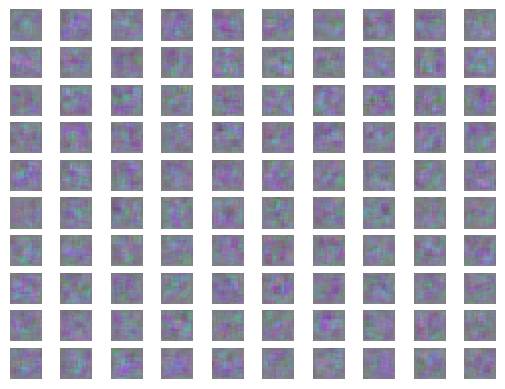

8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 1/11, D_loss = 0.012, G_loss = 0.251
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 2/11, D_loss = 0.005, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 3/11, D_loss = 0.004, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 4/11, D_loss = 0.021, G_loss = 0.251
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 5/11, D_loss = 0.011, G_loss = 0.251
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 6/11, D_loss = 0.020, G_loss = 0.252
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 7/11, D_loss = 0.018, G_loss = 0.251
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 8/11, D_loss = 0.009, G_loss = 0.251
8/8 [==============================] - 0s 2ms/step
Epoch 51, Iteration 9/11, D_loss = 0.007, G_loss = 0.251
8/8 [=======================

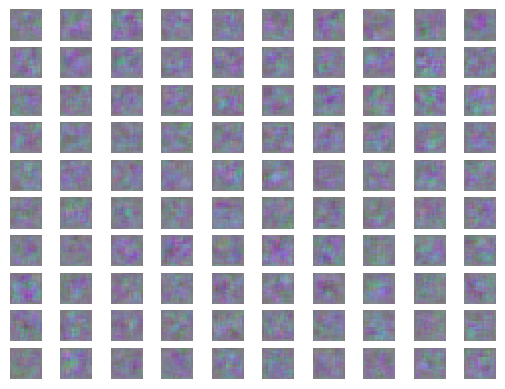

8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 1/11, D_loss = 0.014, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 2/11, D_loss = 0.005, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 3/11, D_loss = 0.007, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 4/11, D_loss = 0.013, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 5/11, D_loss = 0.006, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 6/11, D_loss = 0.008, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 7/11, D_loss = 0.004, G_loss = 0.251
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 8/11, D_loss = 0.011, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 61, Iteration 9/11, D_loss = 0.004, G_loss = 0.250
8/8 [=======================

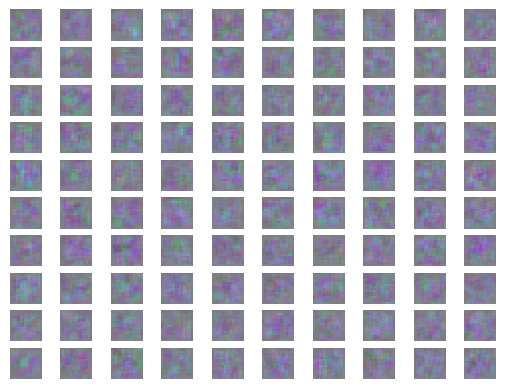

8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 1/11, D_loss = 0.006, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 2/11, D_loss = 0.006, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 3/11, D_loss = 0.005, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 4/11, D_loss = 0.009, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 5/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 6/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 7/11, D_loss = 0.002, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 8/11, D_loss = 0.003, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 71, Iteration 9/11, D_loss = 0.004, G_loss = 0.249
8/8 [=======================

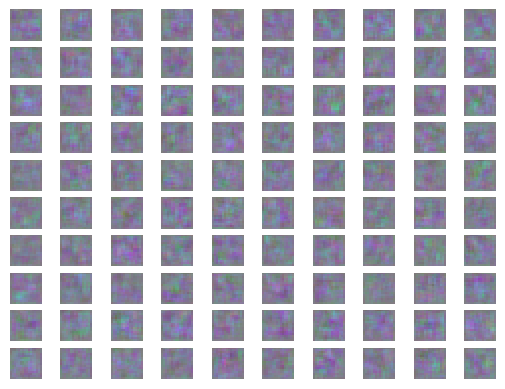

8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 1/11, D_loss = 0.003, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 2/11, D_loss = 0.004, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 3/11, D_loss = 0.012, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 4/11, D_loss = 0.003, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 5/11, D_loss = 0.008, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 6/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 7/11, D_loss = 0.002, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 8/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 81, Iteration 9/11, D_loss = 0.008, G_loss = 0.250
8/8 [=======================

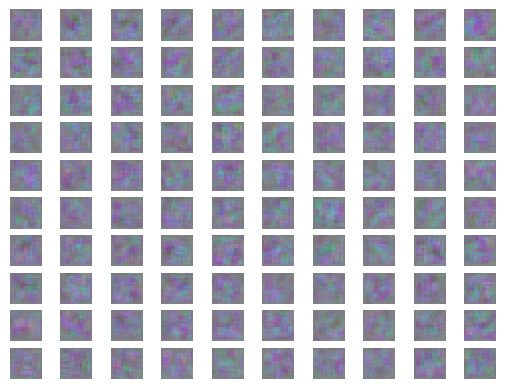

8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 1/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 2/11, D_loss = 0.008, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 3/11, D_loss = 0.007, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 4/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 5/11, D_loss = 0.009, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 6/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 7/11, D_loss = 0.002, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 8/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 91, Iteration 9/11, D_loss = 0.002, G_loss = 0.249
8/8 [=======================

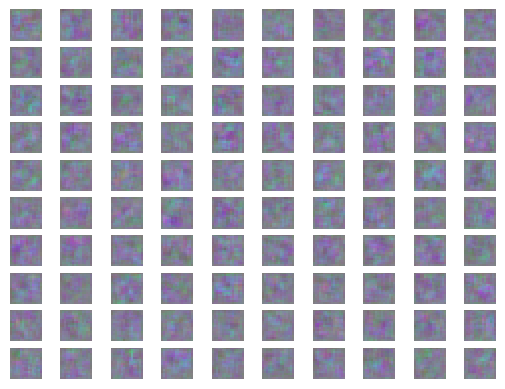

8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 1/11, D_loss = 0.001, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 2/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 3/11, D_loss = 0.011, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 4/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 5/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 6/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 7/11, D_loss = 0.013, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 8/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 101, Iteration 9/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============

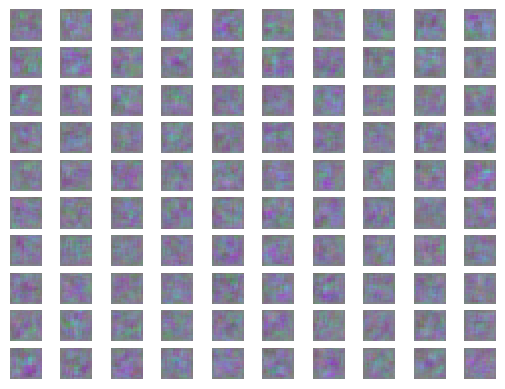

8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 1/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 2/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 3/11, D_loss = 0.001, G_loss = 0.250
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 4/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 5/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 6/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 7/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 8/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 111, Iteration 9/11, D_loss = 0.007, G_loss = 0.249
8/8 [==============

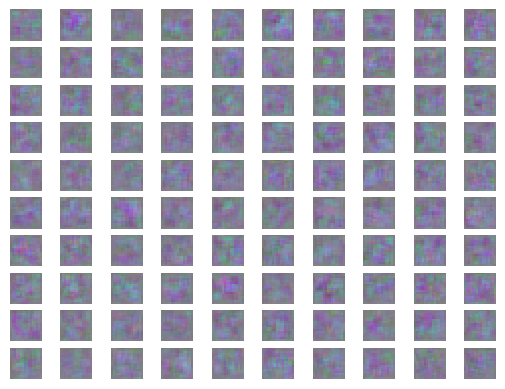

8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 1/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 2/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 3/11, D_loss = 0.003, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 4/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 5/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 6/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 7/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 8/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 121, Iteration 9/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============

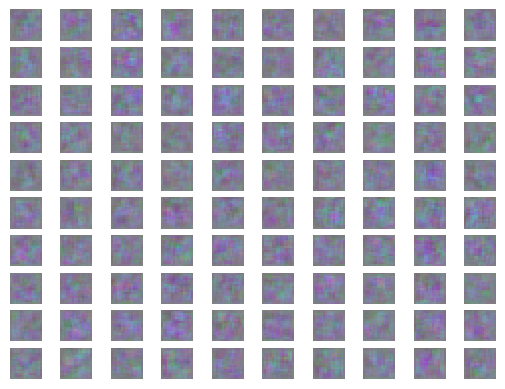

8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 1/11, D_loss = 0.011, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 2/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 3/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 4/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 5/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 6/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 7/11, D_loss = 0.007, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 8/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 131, Iteration 9/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============

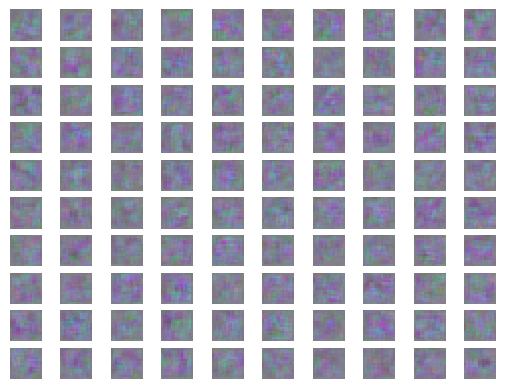

8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 1/11, D_loss = 0.005, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 2/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 3/11, D_loss = 0.002, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 4/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 5/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 6/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 7/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 8/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 141, Iteration 9/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============

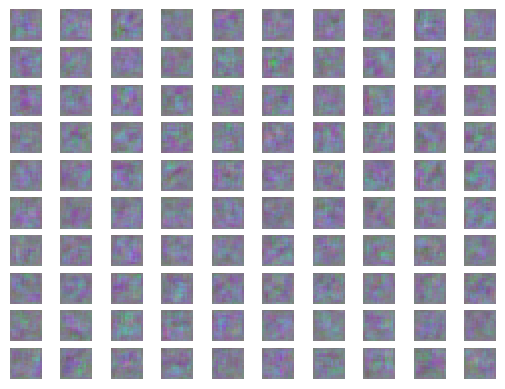

8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 1/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 2/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 3/11, D_loss = 0.012, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 4/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 5/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 6/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 7/11, D_loss = 0.005, G_loss = 0.248
8/8 [==============================] - 0s 4ms/step
Epoch 151, Iteration 8/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 151, Iteration 9/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============

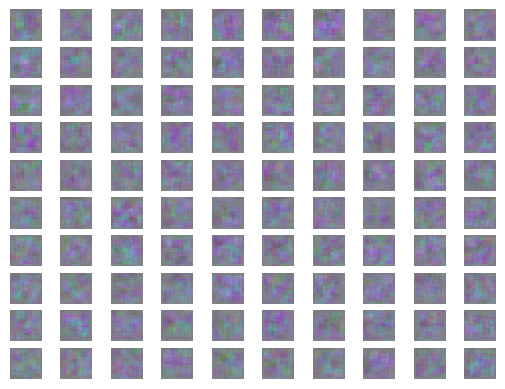

8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 2/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 3/11, D_loss = 0.000, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 6/11, D_loss = 0.005, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 7/11, D_loss = 0.000, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 8/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 161, Iteration 9/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============

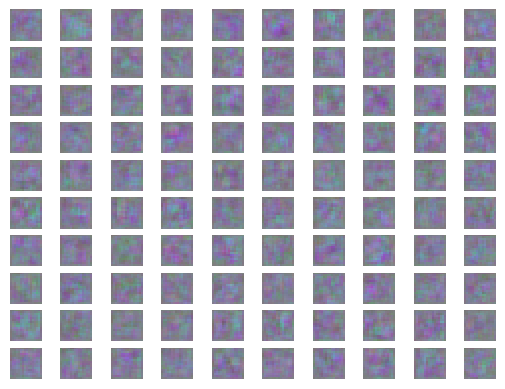

8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 1/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 2/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 3/11, D_loss = 0.005, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 4/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 5/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 6/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 7/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 8/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 171, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

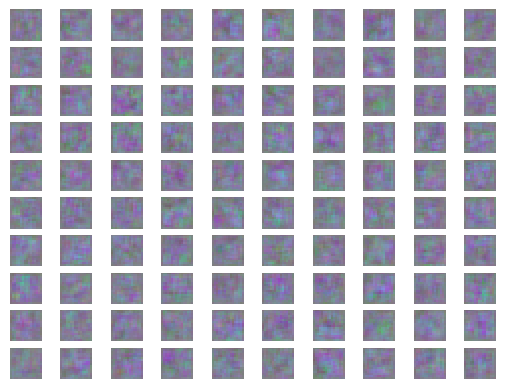

8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 1/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 2/11, D_loss = 0.004, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 3/11, D_loss = 0.002, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 4/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 5/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 7/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 181, Iteration 9/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============

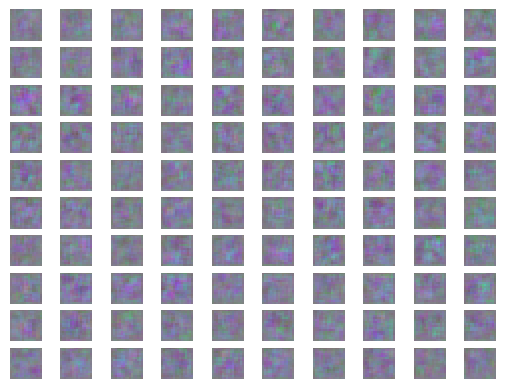

8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 1/11, D_loss = 0.002, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 2/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 8/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 191, Iteration 9/11, D_loss = 0.000, G_loss = 0.249
8/8 [==============

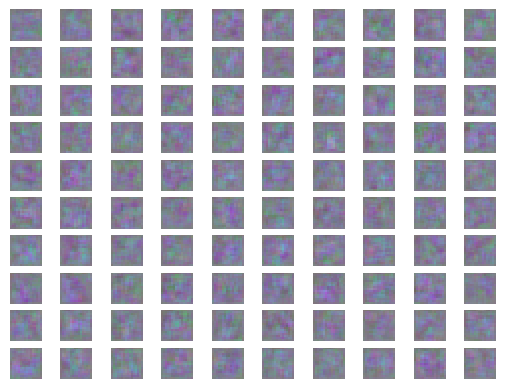

8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 1/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 4/11, D_loss = 0.000, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 5/11, D_loss = 0.002, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 7/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 8/11, D_loss = 0.002, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 201, Iteration 9/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============

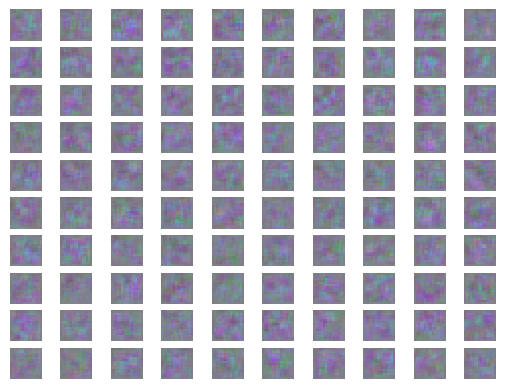

8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 3/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 5/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 211, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

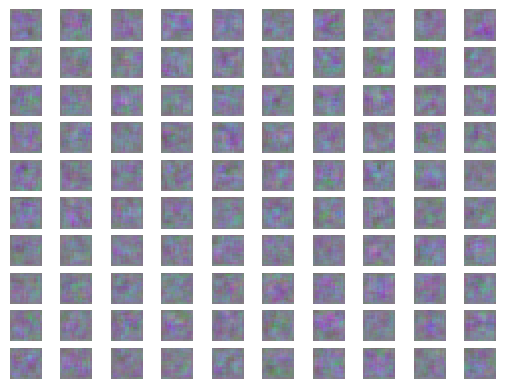

8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 1/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 3/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 4/11, D_loss = 0.000, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 6/11, D_loss = 0.002, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 7/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 8/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 221, Iteration 9/11, D_loss = 0.001, G_loss = 0.249
8/8 [==============

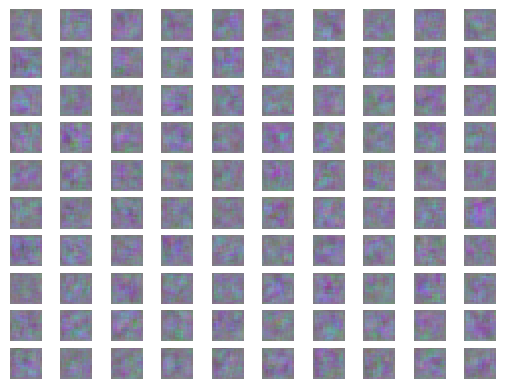

8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 1/11, D_loss = 0.002, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 5/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 231, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

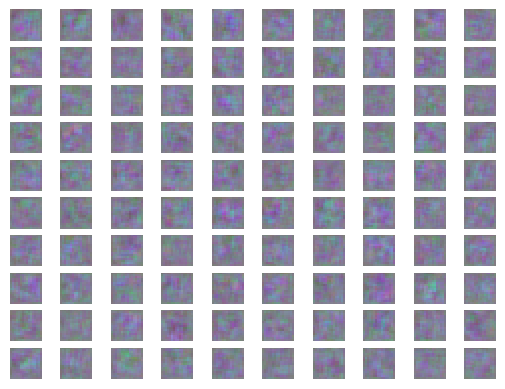

8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 2/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 6/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 241, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

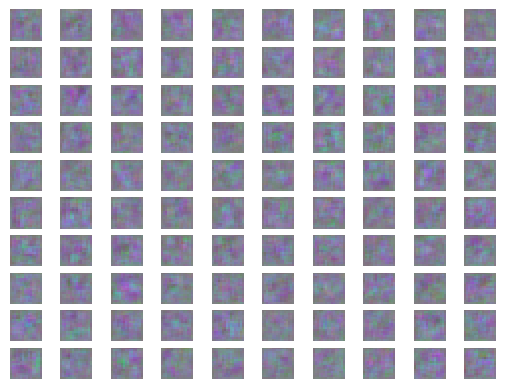

8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 5/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 7/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 251, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

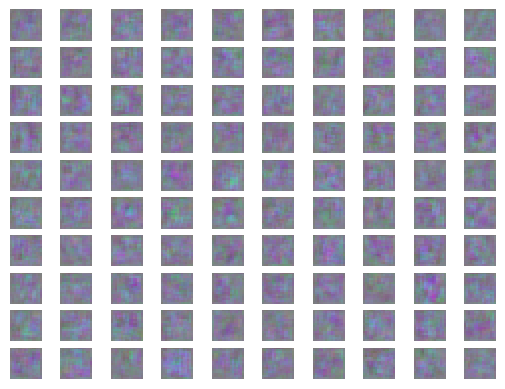

8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 3/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 4/11, D_loss = 0.000, G_loss = 0.249
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 261, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

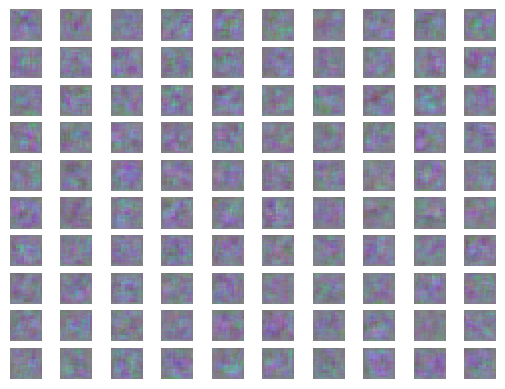

8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 2/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 7/11, D_loss = 0.002, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 271, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

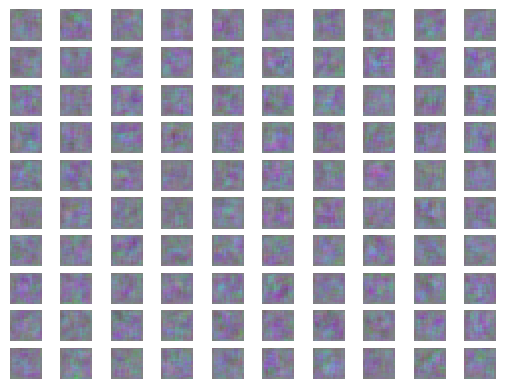

8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 7/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 281, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

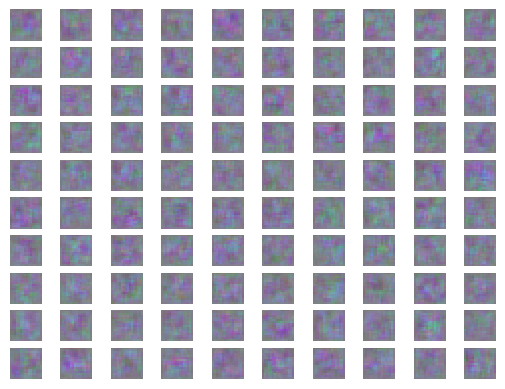

8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 291, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

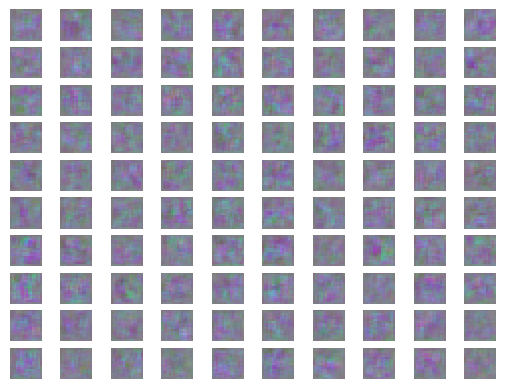

8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 2/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 4/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 301, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

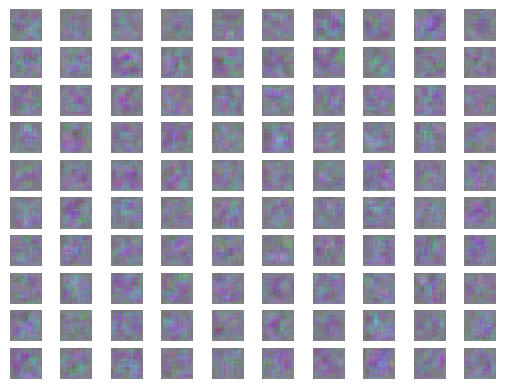

8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 6/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 311, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

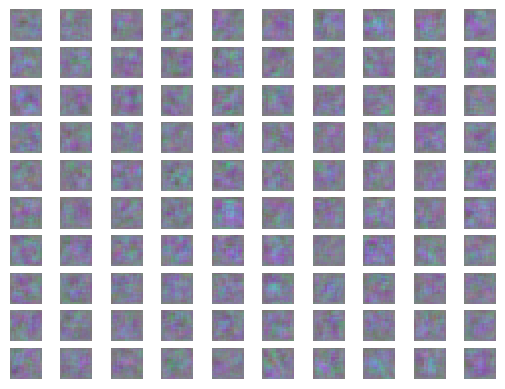

8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 321, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

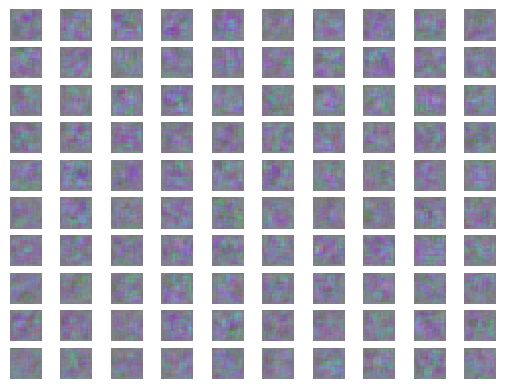

8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 6/11, D_loss = 0.003, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 7/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 8/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 331, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

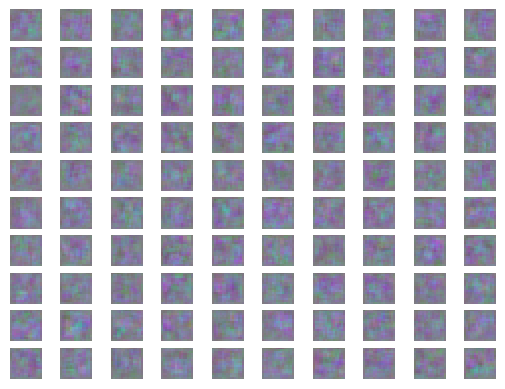

8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 1/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 6/11, D_loss = 0.000, G_loss = 0.247
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 341, Iteration 9/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============

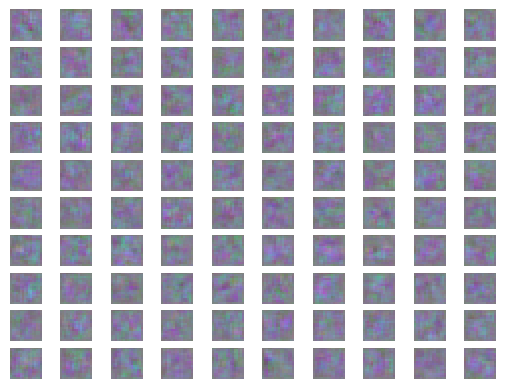

8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 6/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 351, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

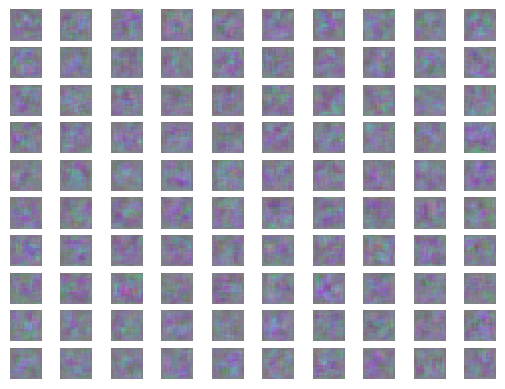

8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 6/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 361, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

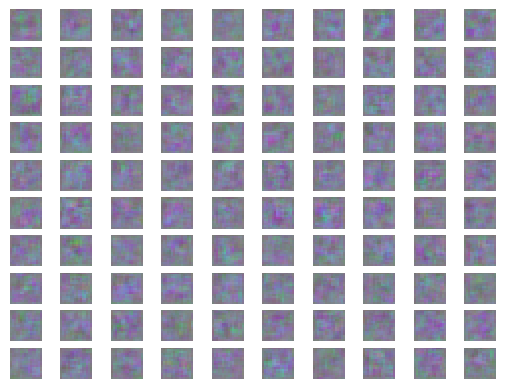

8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 3/11, D_loss = 0.000, G_loss = 0.247
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 8/11, D_loss = 0.001, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 371, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

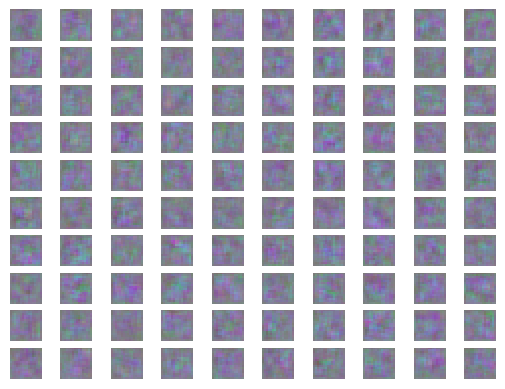

8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 381, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

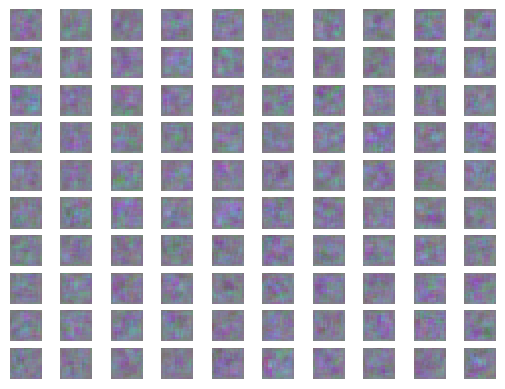

8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 1/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 2/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 3/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 4/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 5/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 6/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 7/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 8/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============================] - 0s 2ms/step
Epoch 391, Iteration 9/11, D_loss = 0.000, G_loss = 0.248
8/8 [==============

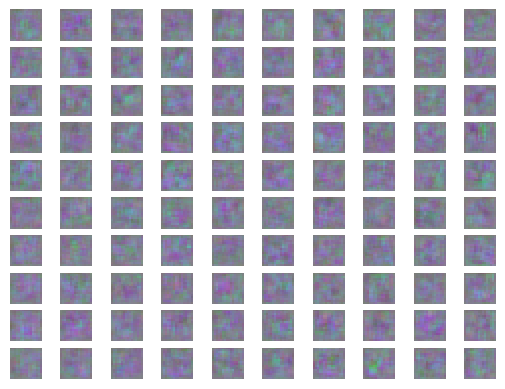

In [23]:

###Main code

latent_dim = 128
epochs = 400
batch_size = 512

# Initialize an optimizer for the Discriminator and Generator
opt = Adam(learning_rate=0.0002, beta_1=0.5)

# Create the Discriminator
d_model = build_discriminator()
d_model.trainable = True
d_model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])

# Create the Generator
g_model = build_generator(latent_dim)

# Create the ProGAN
d_model.trainable = False
gan_model, _, _ = build_progan(latent_dim)  # Only need the first element of the tuple (gan_model)

# Train the GAN
d_losses, g_losses = train_progan(g_model, d_model, gan_model, real_dataset, latent_dim, epochs, batch_size)

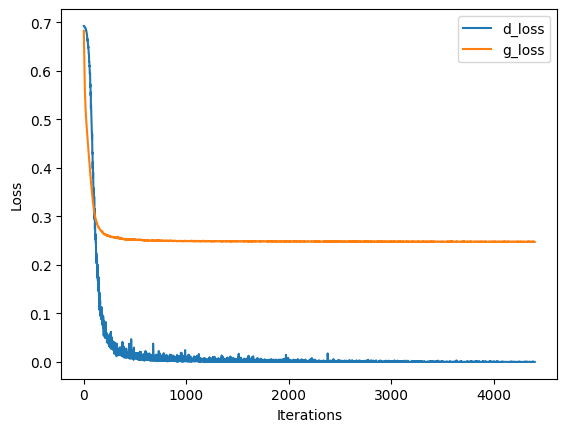

In [24]:
### Plot the training loss of the Generator and the Discriminator over iterations

# Initialize values of x-axis (iterations)
dx = np.linspace(0, len(d_losses), len(d_losses))
gx = np.linspace(0,len(g_losses), len(d_losses))

# Plot the training loss of G and D
plt.plot(dx, d_losses)
plt.plot(gx, g_losses)
plt.ylabel('Loss')
plt.xlabel('Iterations')
plt.legend(['d_loss', 'g_loss'], loc='upper right')
plt.show()

In [31]:

### Show some generated samples

#x,y = generate_fake_samples(g_model, latent_dim, 5)
#save_plot_progan(x, 400,5)